In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
from torch import nn
from torch.nn.functional import relu
from scipy.io import loadmat
import os
from os import listdir
import pandas as pd
from skimage import io
from PIL import Image
from sklearn.metrics import confusion_matrix
import seaborn as sn
import pickle

from utils import *

### Check Imbalance

#### Goose 1st series

In [7]:
val_dates = ['180327','180329']
test_dates = ['180330','180331']
bad_dates = ['180328','180326']
load_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_1st_2/'
test_imbalance(load_path, val_dates, test_dates, bad_dates, test_train=True)

val dates: ['180327', '180329'], test dates: ['180330', '180331']
val instances: 6284, val imbalance: 0.7856460809707642
test instances: 6249, test imbalance: 0.7385181784629822
train instances: 21590, train imbalance: 0.5


#### Goose 1st and 2nd series

In [11]:
val_dates = ['180409', '180412', '180414']
test_dates = ['180411', '180413']
bad_dates = ['180328','180326','180410']
load_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/'
test_imbalance(load_path, val_dates, test_dates, bad_dates, test_train=True)

val dates: ['180409', '180412', '180414'], test dates: ['180411', '180413']
val instances: 6620, val imbalance: 0.8261329531669617
test instances: 6134, test imbalance: 0.7402999401092529
train instances: 45880, train imbalance: 0.5


#### Goose and Jester

In [16]:
val_dates = ['171021','171023','180711','180714']
test_dates = ['171020','171022','180712','180713']
load_path = '/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/'
test_imbalance(load_path, val_dates, test_dates, bad_dates, test_train=True)

val dates: ['171021', '171023', '180711', '180714'], test dates: ['171020', '171022', '180712', '180713']
val instances: 5892, val imbalance: 0.8616768717765808
test instances: 6318, test imbalance: 0.8211459517478943
train instances: 70422, train imbalance: 0.5


In [9]:
CH = 'all'
device = torch.device('cuda')
val_dates = ['180409', '180412', '180414']
test_dates = ['180411', '180413']
bad_dates = ['180326', '180328', '171019', '180715', '180716', '180717']
load_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/'
save_path = '/mnt/pesaranlab/People/Capstone_students/Yue/model/model_Goose_all_2_upsample'

test_imbalance(load_path, val_dates, test_dates, bad_dates = [], test_train=True)
train_files, val_files, test_files = create_files(load_path, val_dates, test_dates, bad_dates)
train_loader, val_loader, test_loader = create_dataloaders(train_files, val_files, test_files, load_path, batch_size=128)

val dates: ['180409', '180412', '180414'], test dates: ['180411', '180413']
val instances: 6620, val imbalance: 0.8261329531669617
test instances: 6134, test imbalance: 0.7402999401092529
train instances: 45880, train imbalance: 0.5


### LR with no regularization

In [10]:
learning_rate = 0.001
num_epochs = 51
alpha = 0
model_type = 'LR'
loss_type = 'bce'
reg_type = 'none'

model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)

0
Train loss for epoch 0: 0.7983394861221313
Val loss for epoch 0: 0.7276170253753662
6
Train loss for epoch 6: 0.38783586025238037
Val loss for epoch 6: 0.671897292137146
15
Train loss for epoch 15: 0.30063238739967346
Val loss for epoch 15: 0.6459863185882568


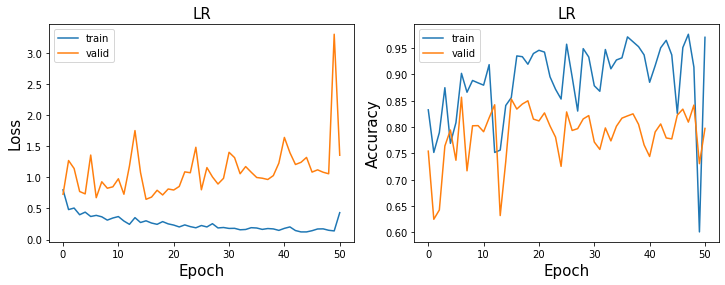

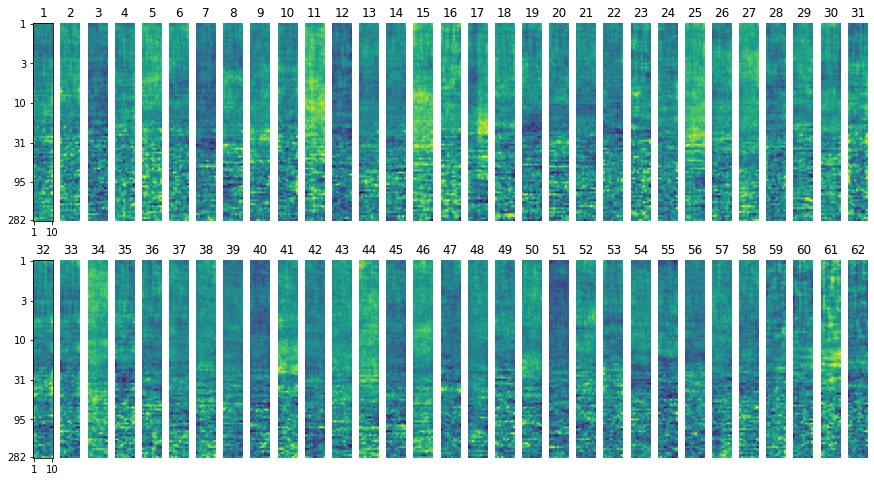

In [7]:
# with adjusted val and test dates
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

0
Train loss for epoch 0: 0.7721514701843262
Val loss for epoch 0: 0.5933133959770203


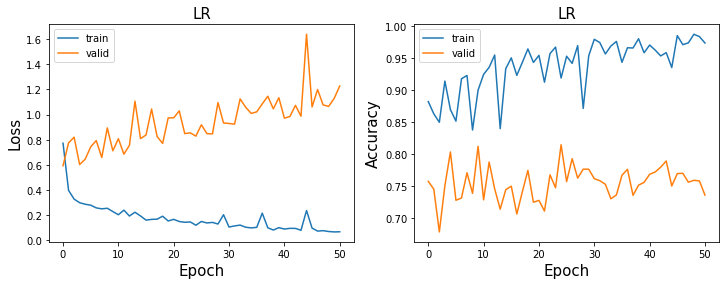

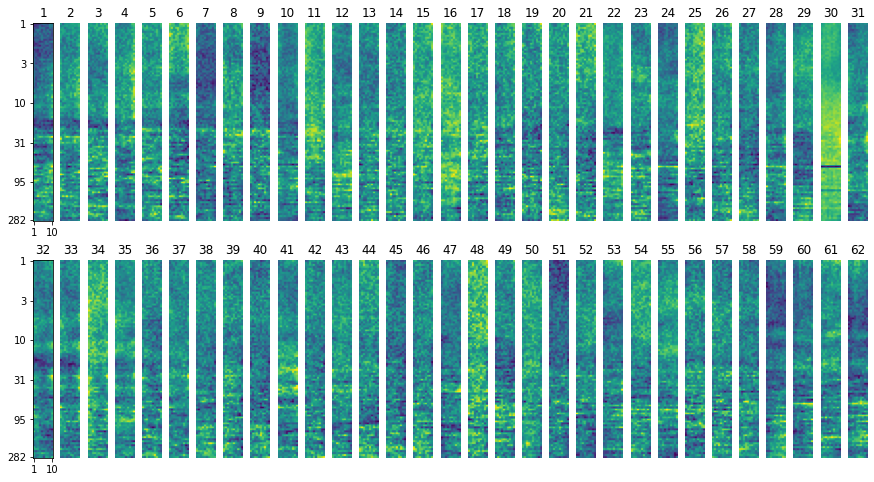

In [14]:
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

In [12]:
(data, labels, _, _, _) = next(iter(train_loader))
data = data.to(device)
output = model(data)
output.shape

torch.Size([128, 1, 1])

In [13]:
w = model.linear.weight.view(62, 100, 10)
w.

In [11]:
best_epoch = 15
model = GLM().to(device)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, best_epoch)))

test_loss, test_acc, test_preds, test_preds_probs, test_labels, _, _, _, _ = evaluate(model, optimizer, test_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(test_loss, test_acc, np.mean(np.concatenate(test_labels))))
plot_weight_glm(device, save_path, model_type, CH, loss_type, reg_type, alpha, best_epoch)
plot_confusion(test_preds, test_labels)

test loss:1.001769781112671, test accuracy:0.7755135311379198, test percentage postive:0.7402999401092529


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/pesaranlab/People/Capstone_students/Yue/model/model_Goose_all_2_upsample/LR_CHall_LOSSbce_REGnone0_TW10_EPOCH15.pt'

In [5]:
### if there exists cuda
# model = GLM().to(device)
# optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
# model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 0)))

### if there does NOT exist cuda
# device = torch.device('cpu')
# model = GLM().to(device)
# optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
# model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 
#                                                                                          0), 
#                                  map_location=torch.device('cpu')))

val loss:0.6459863185882568, val accuracy:0.8531722054380665, val percentage postive:0.8261329531669617


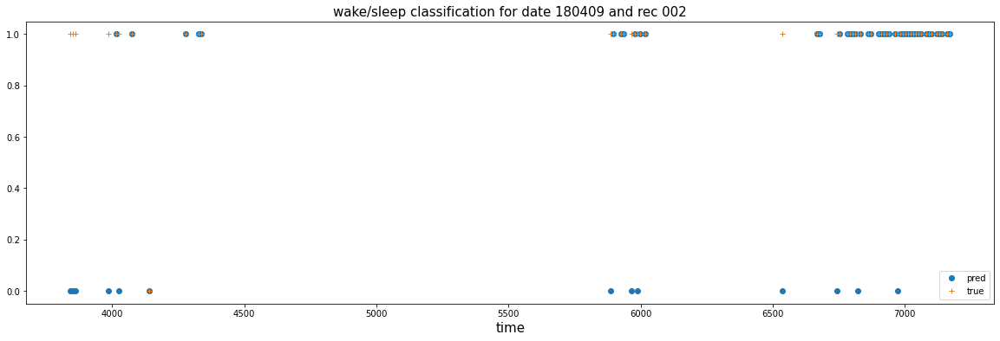

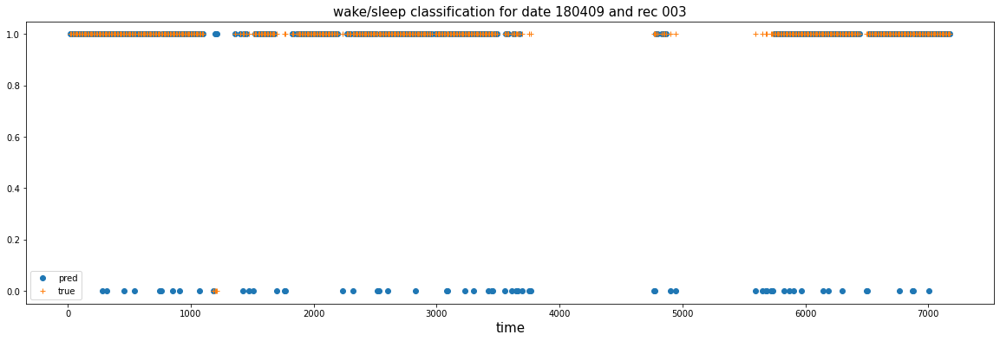

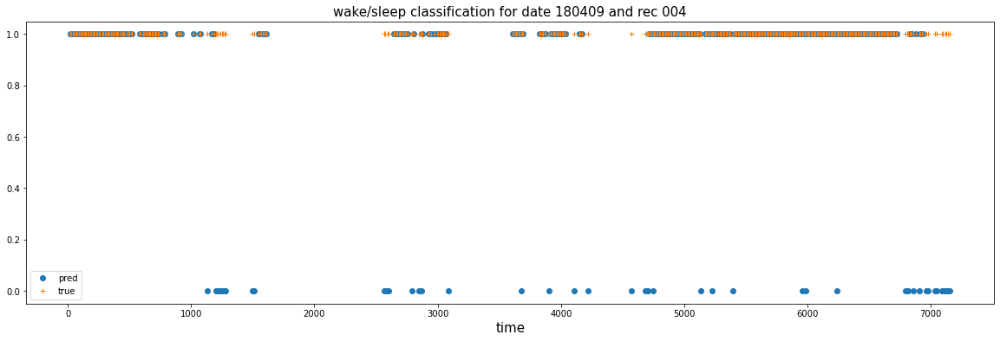

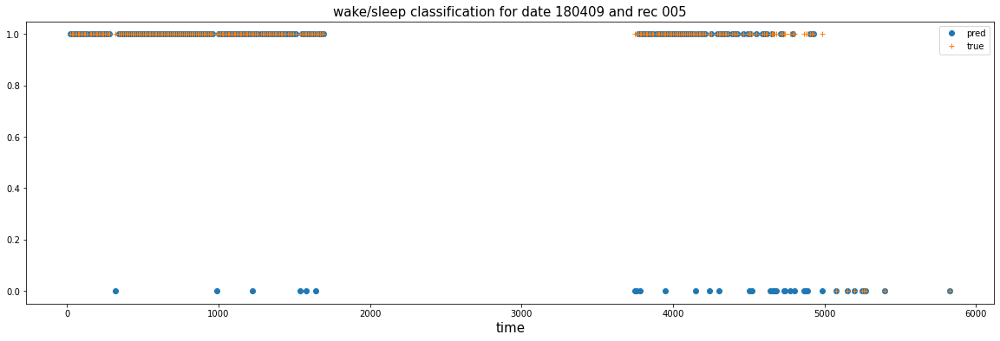

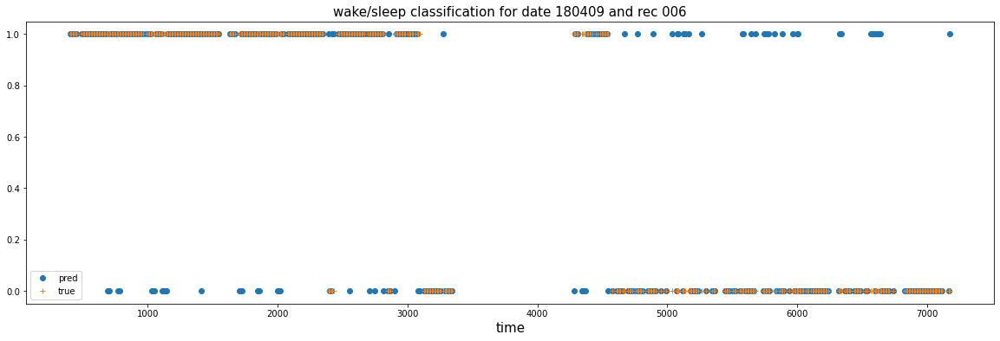

In [24]:
val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

test loss:0.13051478564739227, test accuracy:0.9594005449591281, test percentage postive:0.5


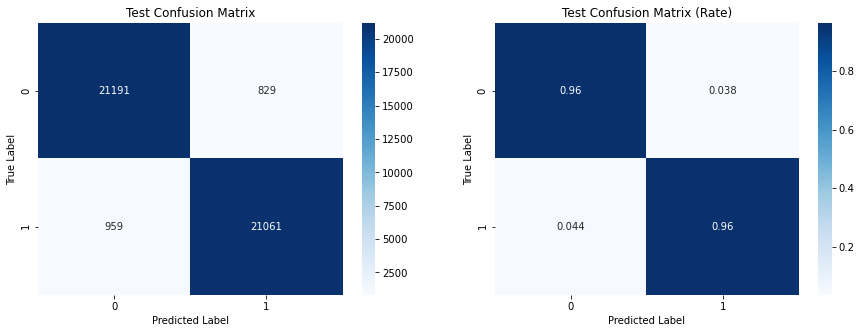

In [7]:
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 50)))


train_loss, train_acc, train_preds, train_preds_probs, train_labels, _, _, _, cases_wrong_train = evaluate(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('train loss:{}, train accuracy:{}, train percentage postive:{}'.format(train_loss, train_acc, np.mean(np.concatenate(train_labels))))
plot_confusion(train_preds, train_labels)

### LR with l2 regularization

In [25]:
learning_rate = 0.001
num_epochs = 51
alpha = 100
model_type = 'LR'
loss_type = 'bce'
reg_type = 'l2'

0
Train loss for epoch 0: 1.05088472366333
Val loss for epoch 0: 0.7739229202270508
6
Train loss for epoch 6: 0.8059943914413452
Val loss for epoch 6: 0.5032647848129272
14
Train loss for epoch 14: 0.7774673700332642
Val loss for epoch 14: 0.43014711141586304
35
Train loss for epoch 35: 0.739650547504425
Val loss for epoch 35: 0.3978760540485382


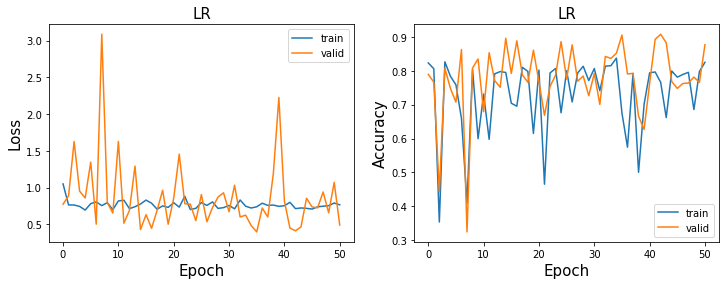

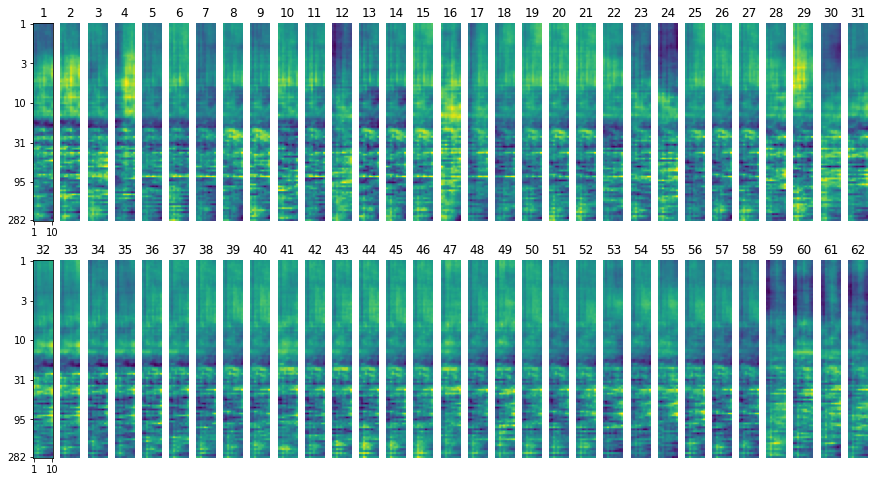

In [9]:
# with adjusted val and test dates
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

0
Train loss for epoch 0: 1.3403551578521729
Val loss for epoch 0: 0.7452813982963562
3
Train loss for epoch 3: 0.32871875166893005
Val loss for epoch 3: 0.6733324527740479
5
Train loss for epoch 5: 0.2865569591522217
Val loss for epoch 5: 0.6254689693450928
7
Train loss for epoch 7: 0.26425063610076904
Val loss for epoch 7: 0.6119723916053772


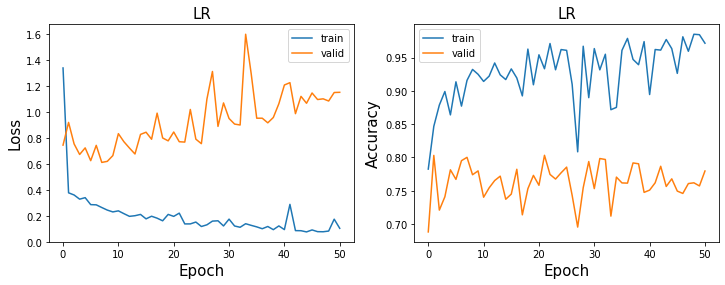

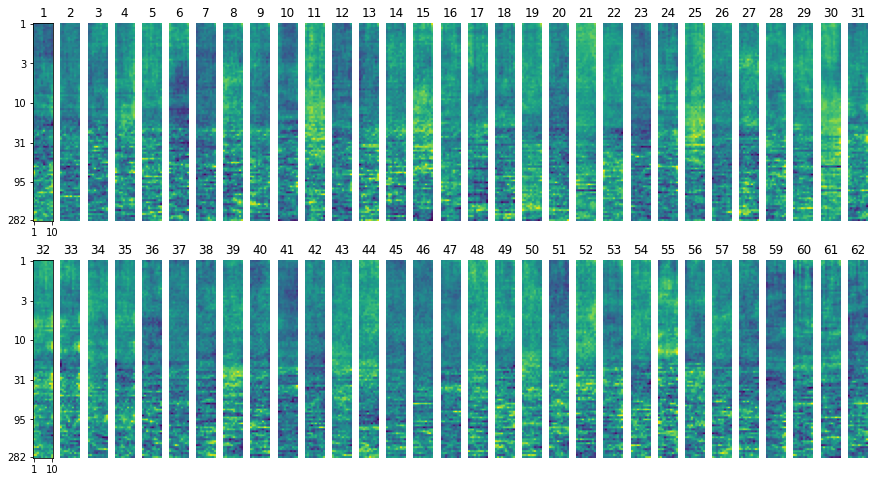

0
Train loss for epoch 0: 0.8613800406455994
Val loss for epoch 0: 0.6665376424789429
1
Train loss for epoch 1: 0.42211973667144775
Val loss for epoch 1: 0.5619068145751953


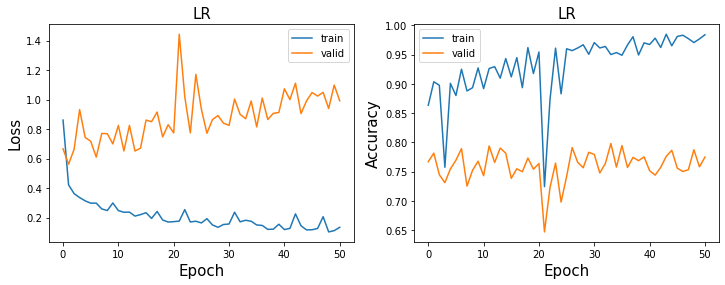

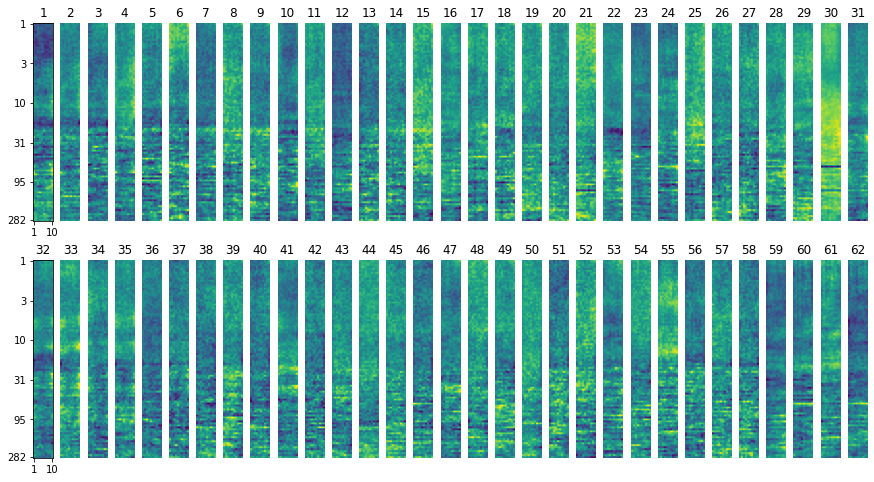

0
Train loss for epoch 0: 0.8191649317741394
Val loss for epoch 0: 0.8420286178588867
1
Train loss for epoch 1: 0.4855543076992035
Val loss for epoch 1: 0.6021063923835754
2
Train loss for epoch 2: 0.3964634835720062
Val loss for epoch 2: 0.5511942505836487
13
Train loss for epoch 13: 0.33288809657096863
Val loss for epoch 13: 0.5505210161209106


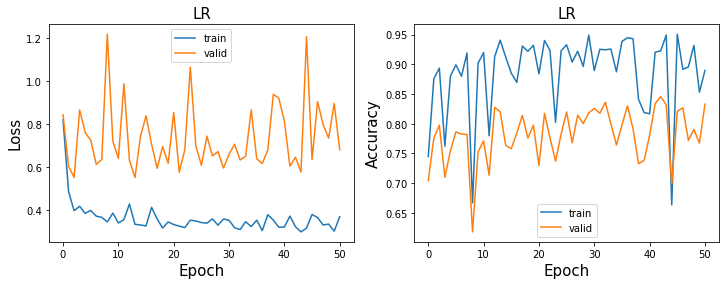

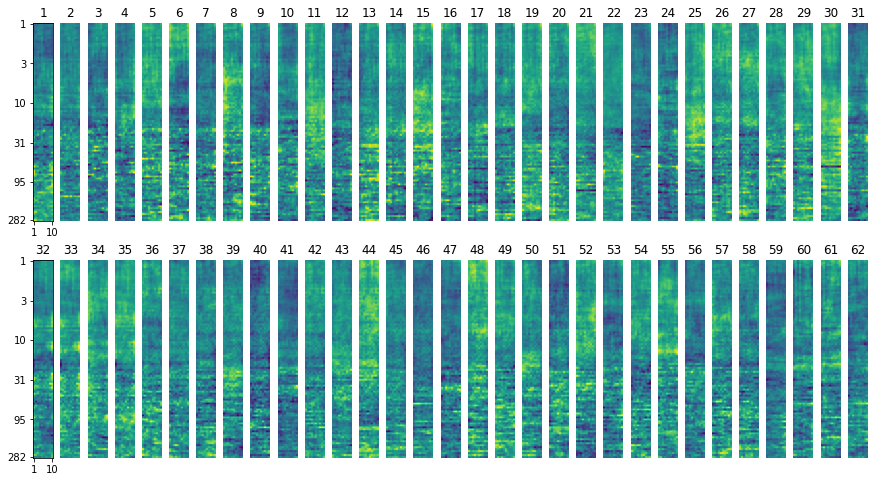

0
Train loss for epoch 0: 0.8771368265151978
Val loss for epoch 0: 0.6537183523178101
1
Train loss for epoch 1: 0.5524464845657349
Val loss for epoch 1: 0.6412380933761597
2
Train loss for epoch 2: 0.5401118993759155
Val loss for epoch 2: 0.5436304211616516
6
Train loss for epoch 6: 0.5262225866317749
Val loss for epoch 6: 0.5090987086296082
12
Train loss for epoch 12: 0.5309434533119202
Val loss for epoch 12: 0.4916950464248657
30
Train loss for epoch 30: 0.5337350368499756
Val loss for epoch 30: 0.47137516736984253


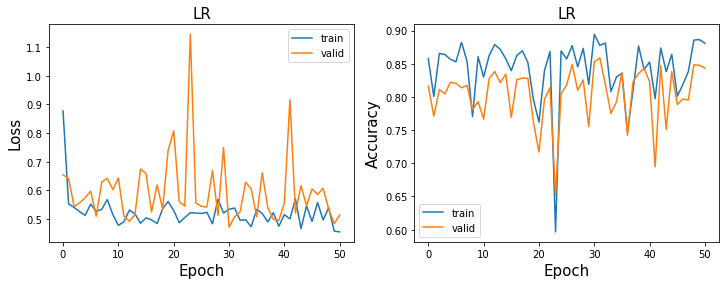

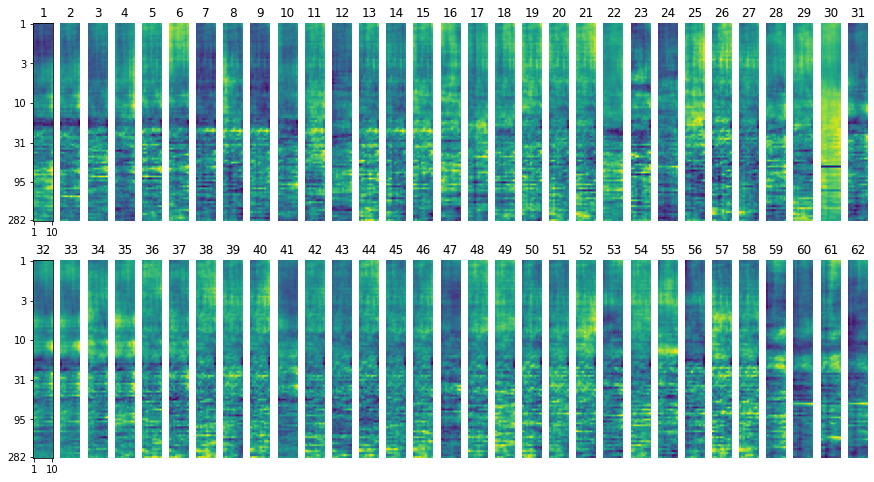

0
Train loss for epoch 0: 1.0427676439285278
Val loss for epoch 0: 0.5432732105255127
4
Train loss for epoch 4: 0.5311232209205627
Val loss for epoch 4: 0.5427658557891846
7
Train loss for epoch 7: 0.564795970916748
Val loss for epoch 7: 0.539776623249054
12
Train loss for epoch 12: 0.5793224573135376
Val loss for epoch 12: 0.5247149467468262
22
Train loss for epoch 22: 0.5972024202346802
Val loss for epoch 22: 0.5102439522743225
25
Train loss for epoch 25: 0.5595686435699463
Val loss for epoch 25: 0.4803539216518402
28
Train loss for epoch 28: 0.6174989938735962
Val loss for epoch 28: 0.4744551479816437


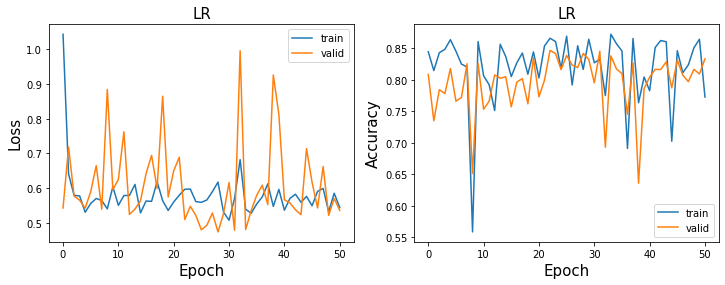

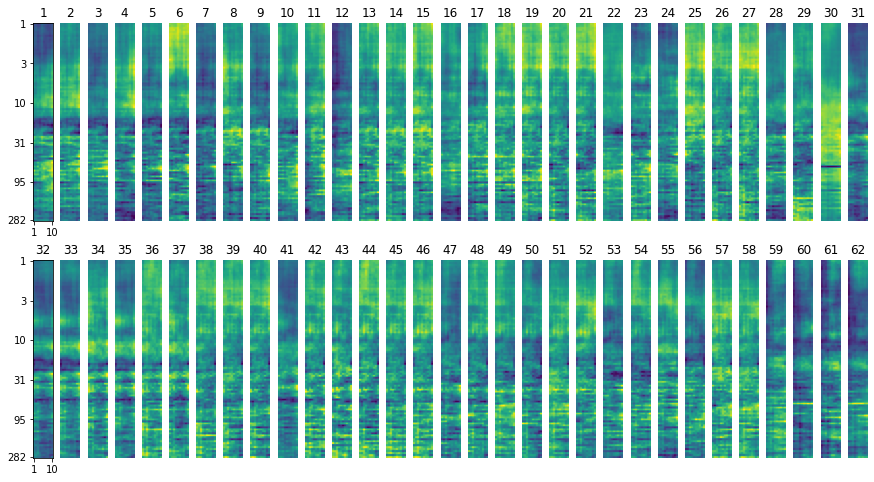

In [5]:
min_val_loss = 100
for alpha in [0.1, 1, 10, 50, 100]:
    model = GLM().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    best_epoch_alpha, min_val_loss_alpha = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)
    if min_val_loss_alpha < min_val_loss:
        min_val_loss = min_val_loss_alpha
        best_epoch = best_epoch_alpha
        best_alpha = alpha

test loss:0.6151620745658875, test accuracy:0.7940984675578742, test percentage postive:0.7402999401092529


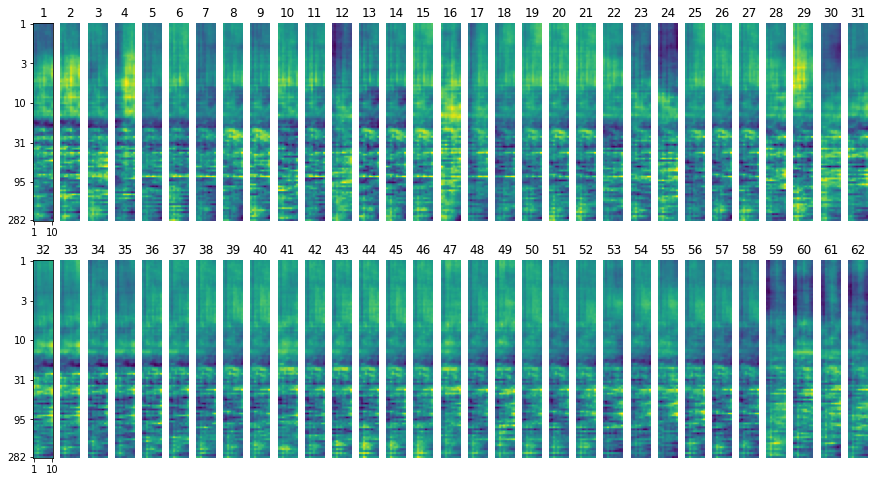

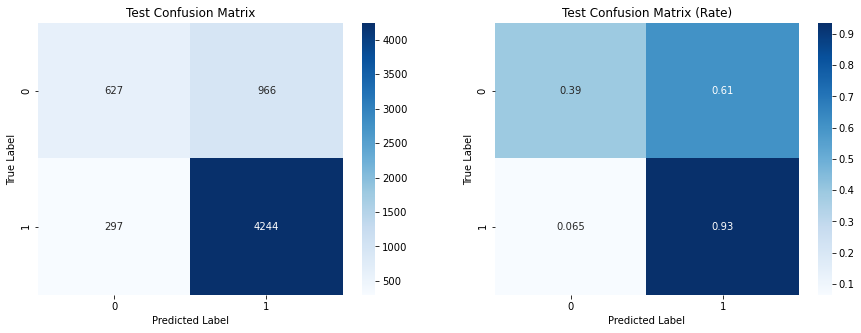

In [26]:
best_epoch, best_alpha = 35, 100
model = GLM().to(device)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)))

test_loss, test_acc, test_preds, test_preds_probs, test_labels, _, _, _, _ = evaluate(model, optimizer, test_loader, alpha=best_alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(test_loss, test_acc, np.mean(np.concatenate(test_labels))))
plot_weight_glm(device, save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)
plot_confusion(test_preds, test_labels)

val loss:0.3978760540485382, val accuracy:0.9052870090634441, val percentage postive:0.8261329531669617


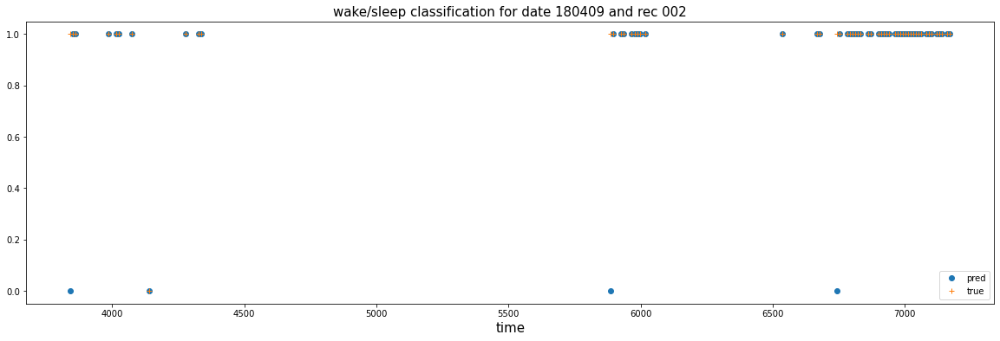

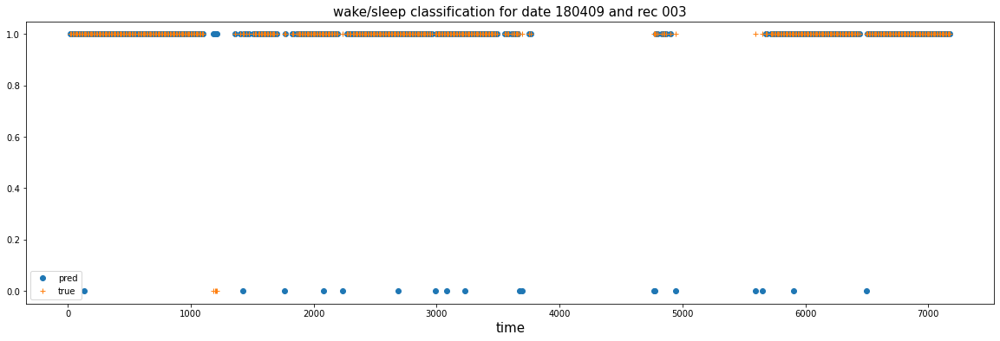

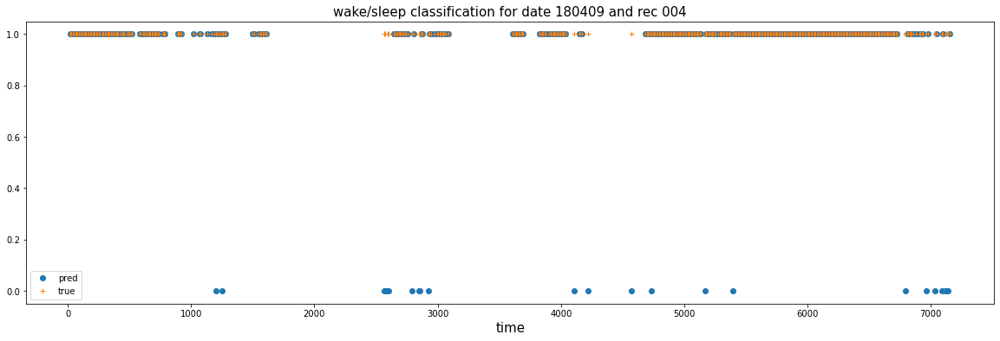

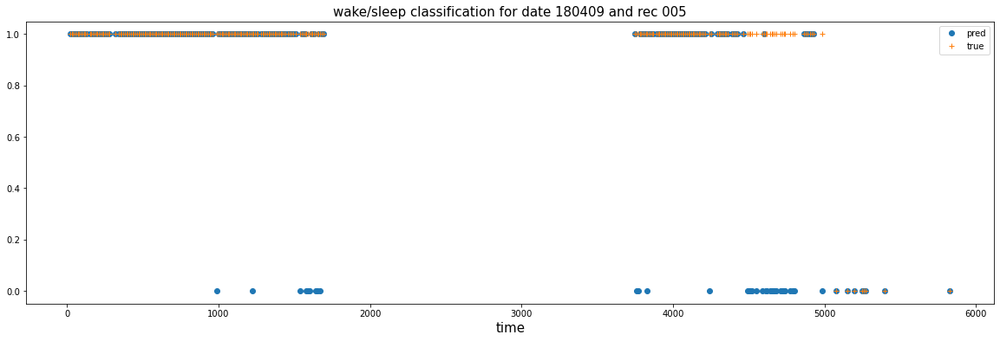

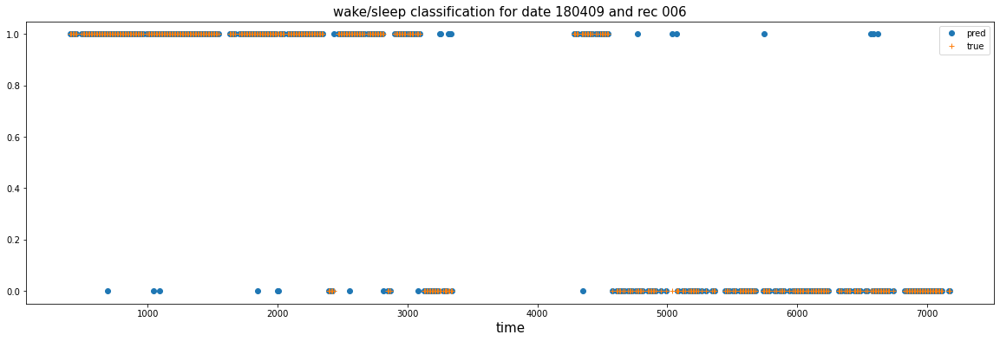

In [27]:
val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

test loss:0.6192336678504944, test accuracy:0.8289282470481381, test percentage postive:0.5


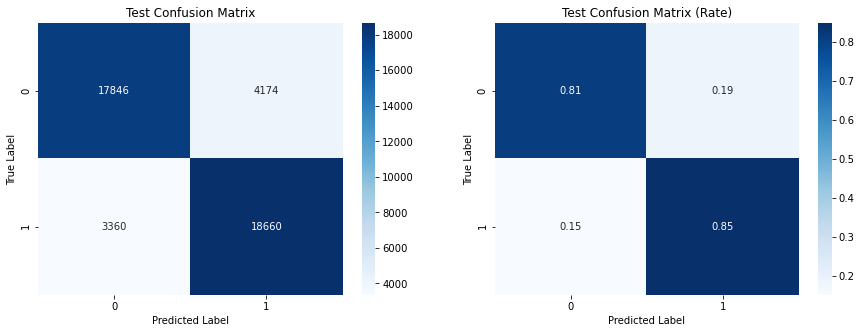

In [16]:
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 50)))


train_loss, train_acc, train_preds, train_preds_probs, train_labels, _, _, _, cases_wrong_train = evaluate(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('train loss:{}, train accuracy:{}, train percentage postive:{}'.format(train_loss, train_acc, np.mean(np.concatenate(train_labels))))
plot_confusion(train_preds, train_labels)

### LR with finite difference regularization

In [17]:
learning_rate = 0.001
num_epochs = 51
alpha = 100
model_type = 'LR'
loss_type = 'bce'
reg_type = 'finite_diff'

0
Train loss for epoch 0: 0.8532299399375916
Val loss for epoch 0: 0.7806753516197205
4
Train loss for epoch 4: 0.675608217716217
Val loss for epoch 4: 0.6444528102874756
5
Train loss for epoch 5: 0.6142752766609192
Val loss for epoch 5: 0.5296273231506348
12
Train loss for epoch 12: 0.6031219363212585
Val loss for epoch 12: 0.5148882269859314
24
Train loss for epoch 24: 0.7151668071746826
Val loss for epoch 24: 0.5108358860015869


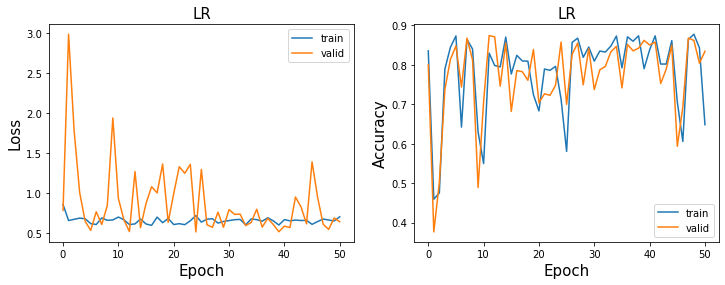

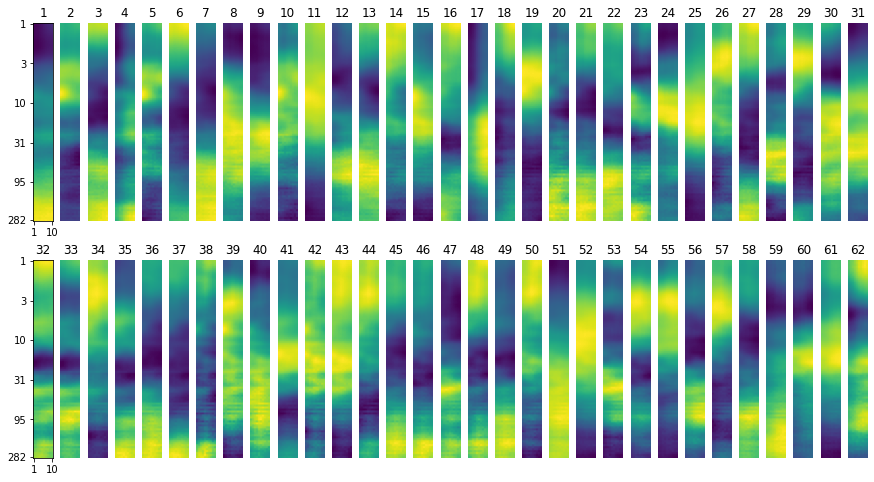

In [11]:
# with adjusted val and test dates
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

0
Train loss for epoch 0: 0.8435953855514526
Val loss for epoch 0: 0.6825738549232483
1
Train loss for epoch 1: 0.368568480014801
Val loss for epoch 1: 0.551176905632019


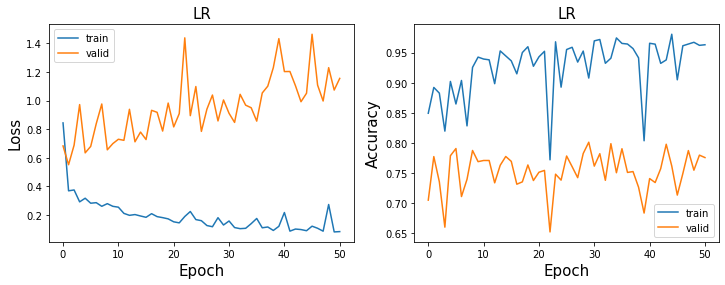

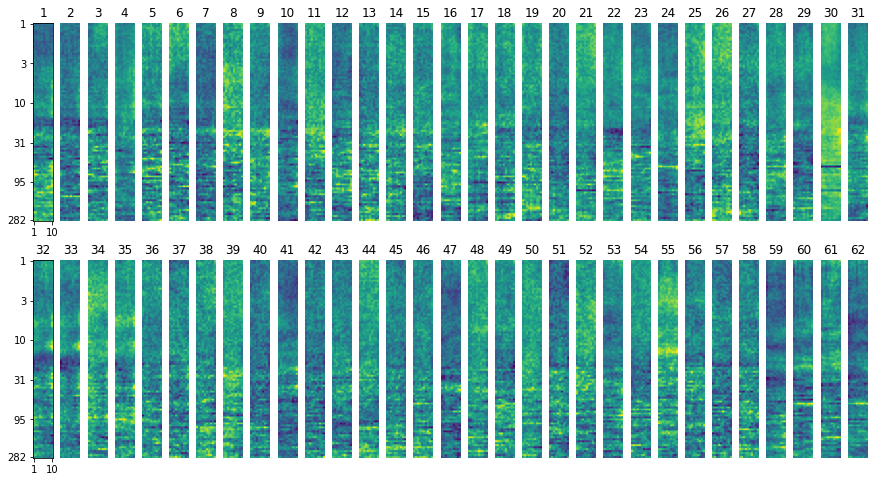

0
Train loss for epoch 0: 0.8070161938667297
Val loss for epoch 0: 0.5593223571777344


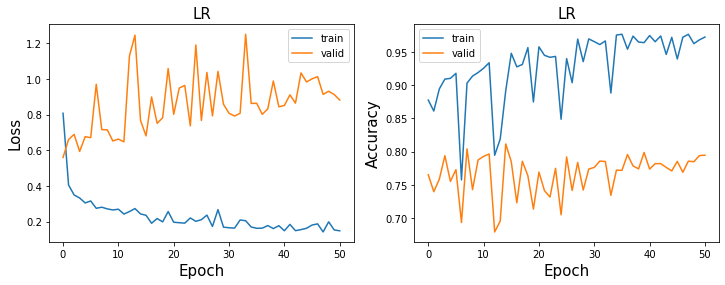

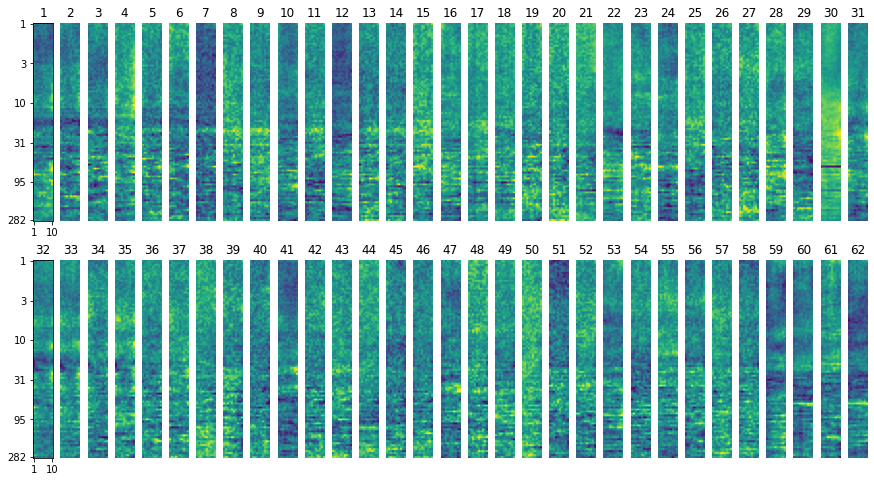

0
Train loss for epoch 0: 0.821603000164032
Val loss for epoch 0: 0.8025758266448975
1
Train loss for epoch 1: 0.43895265460014343
Val loss for epoch 1: 0.6666890978813171
3
Train loss for epoch 3: 0.39532989263534546
Val loss for epoch 3: 0.5358427166938782


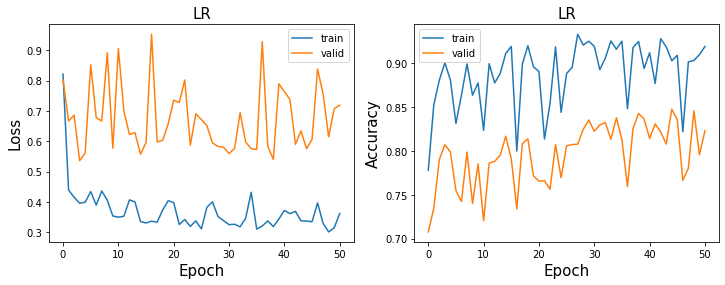

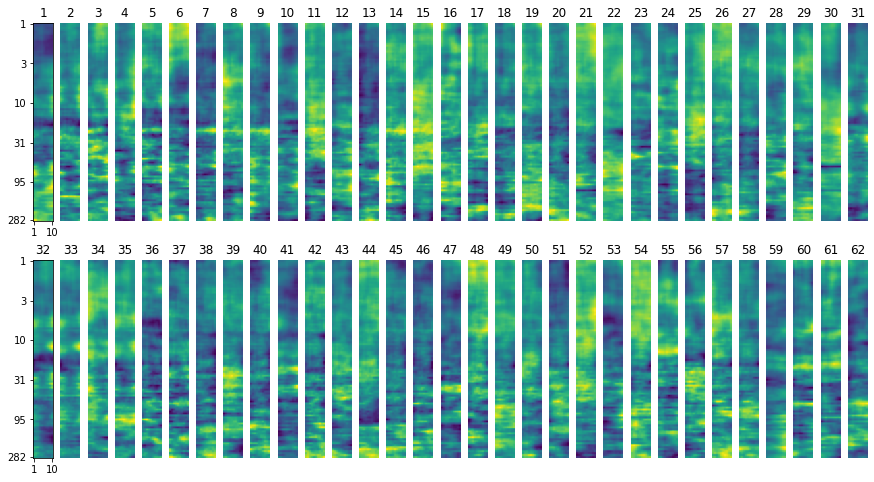

0
Train loss for epoch 0: 0.9539598822593689
Val loss for epoch 0: 0.5365521311759949
7
Train loss for epoch 7: 0.4465812146663666
Val loss for epoch 7: 0.5318204760551453
8
Train loss for epoch 8: 0.4327021837234497
Val loss for epoch 8: 0.526685893535614
13
Train loss for epoch 13: 0.45602506399154663
Val loss for epoch 13: 0.5186755061149597
19
Train loss for epoch 19: 0.45070919394493103
Val loss for epoch 19: 0.5156132578849792
24
Train loss for epoch 24: 0.40243765711784363
Val loss for epoch 24: 0.48171183466911316
41
Train loss for epoch 41: 0.467625230550766
Val loss for epoch 41: 0.4685782790184021


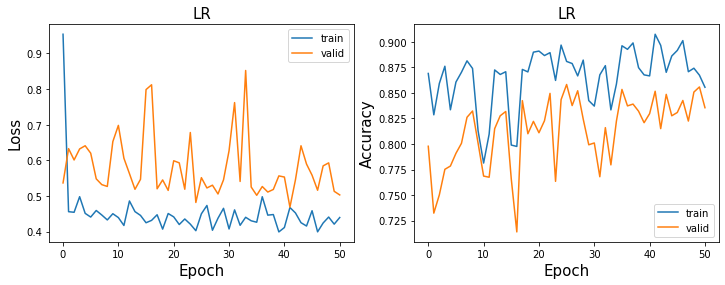

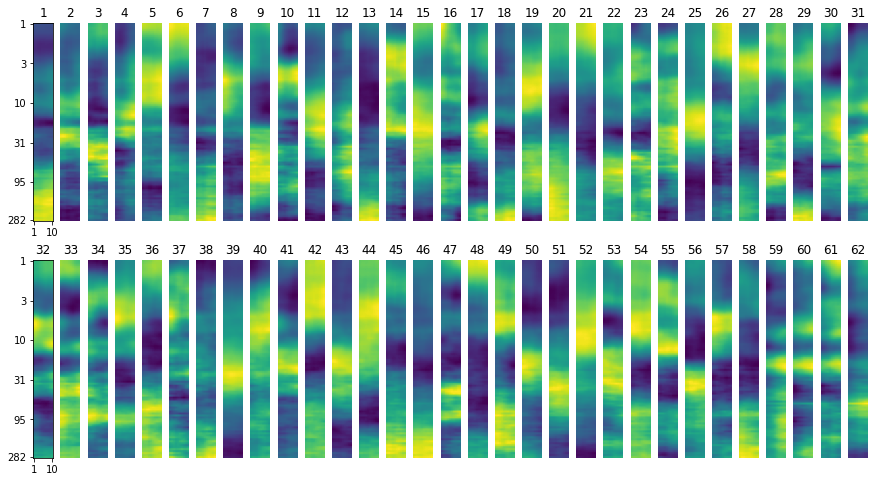

0
Train loss for epoch 0: 1.3144859075546265
Val loss for epoch 0: 0.5789328813552856
1
Train loss for epoch 1: 0.49841126799583435
Val loss for epoch 1: 0.5640434622764587
4
Train loss for epoch 4: 0.4664522111415863
Val loss for epoch 4: 0.5353770852088928
9
Train loss for epoch 9: 0.42811086773872375
Val loss for epoch 9: 0.49244657158851624
31
Train loss for epoch 31: 0.44656598567962646
Val loss for epoch 31: 0.48424819111824036
41
Train loss for epoch 41: 0.4569268822669983
Val loss for epoch 41: 0.45805808901786804


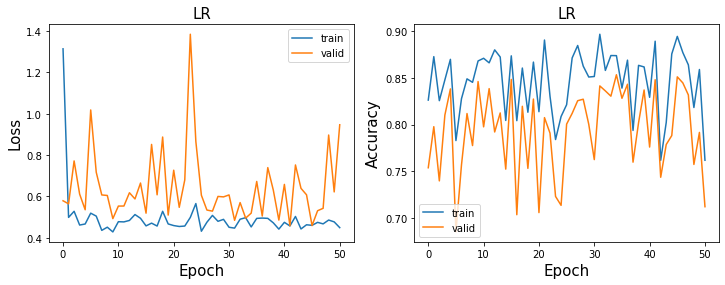

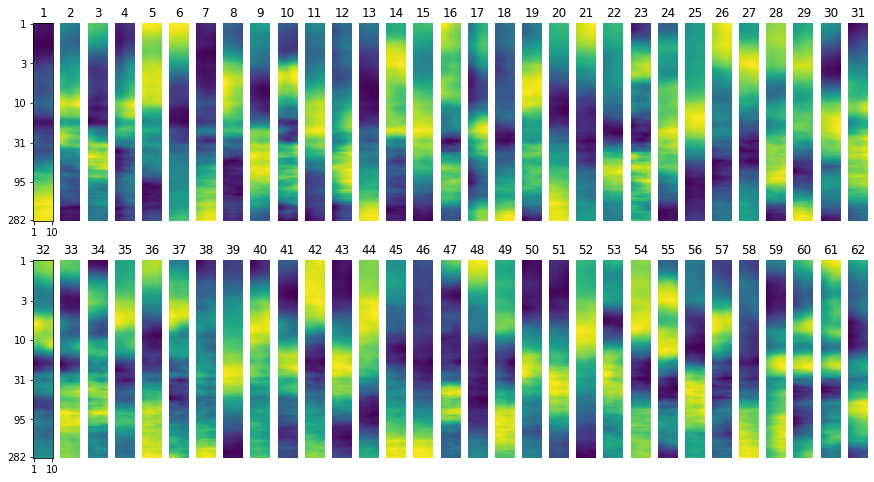

In [8]:
min_val_loss = 100
for alpha in [0.1, 1, 10, 50, 100]:
    model = GLM().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    best_epoch_alpha, min_val_loss_alpha = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)
    if min_val_loss_alpha < min_val_loss:
        min_val_loss = min_val_loss_alpha
        best_epoch = best_epoch_alpha
        best_alpha = alpha

test loss:0.6910374760627747, test accuracy:0.7792631235735246, test percentage postive:0.7402999401092529


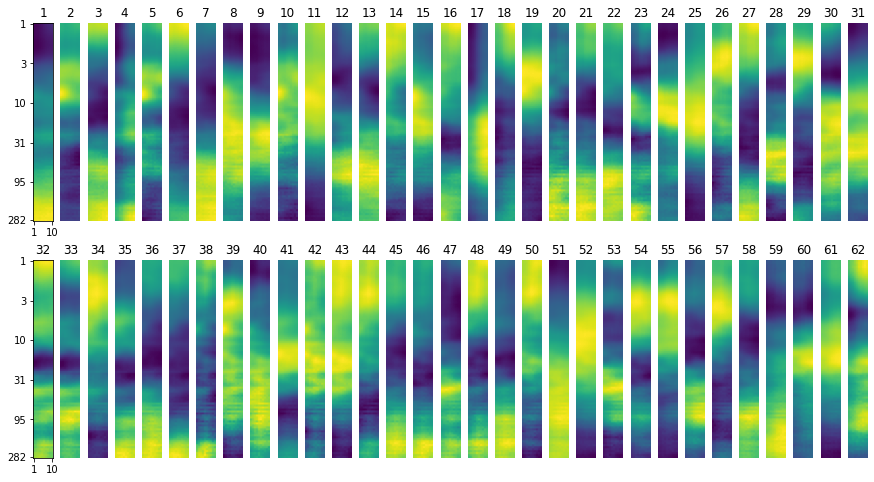

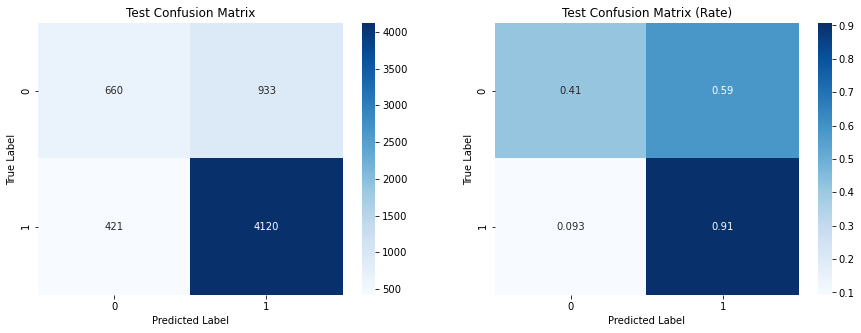

In [19]:
best_epoch, best_alpha = 24, 100
model = GLM().to(device)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)))

test_loss, test_acc, test_preds, test_preds_probs, test_labels, _, _, _, _ = evaluate(model, optimizer, test_loader, alpha=best_alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(test_loss, test_acc, np.mean(np.concatenate(test_labels))))
plot_weight_glm(device, save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)
plot_confusion(test_preds, test_labels)

val loss:0.5108358860015869, val accuracy:0.8578549848942598, val percentage postive:0.8261329531669617


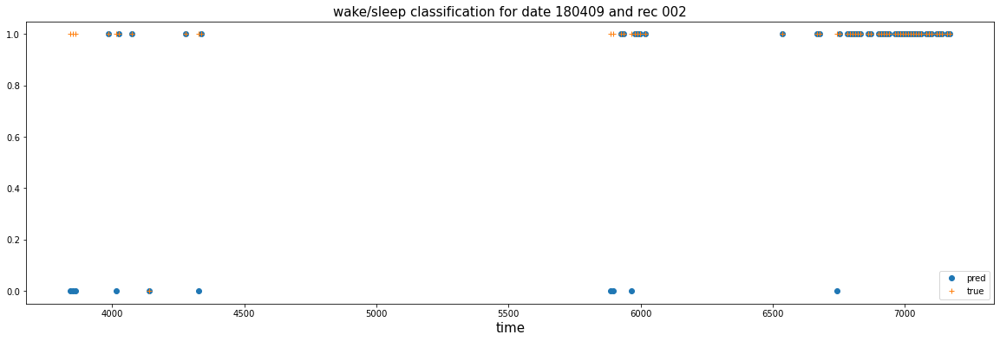

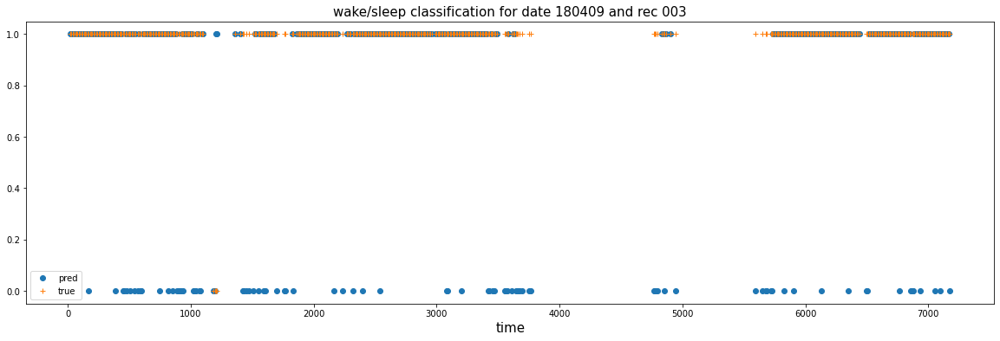

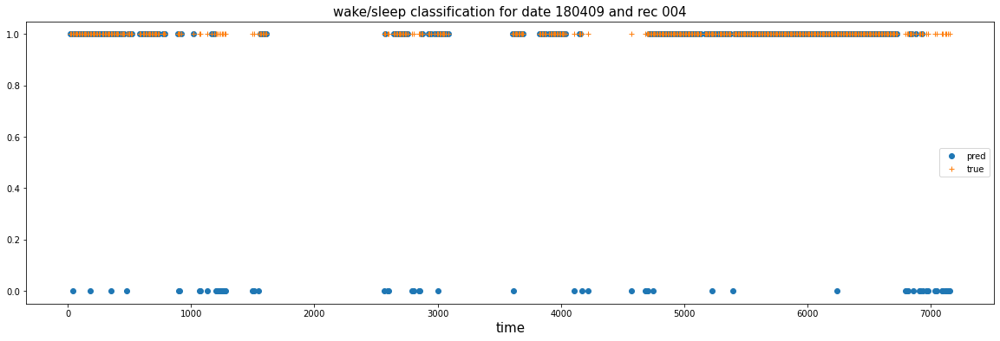

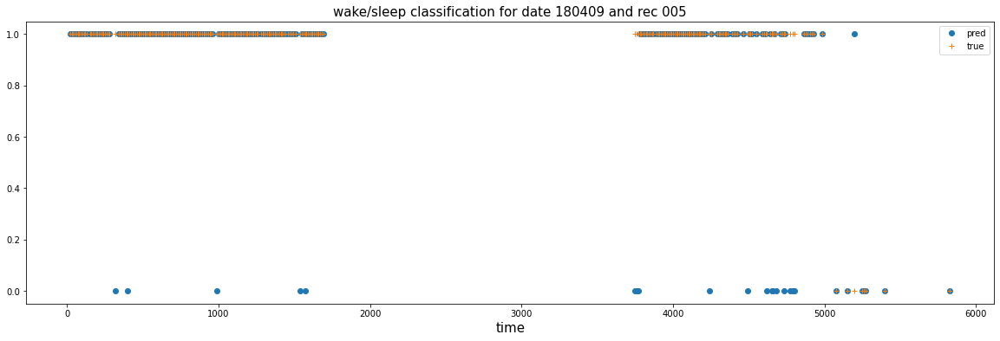

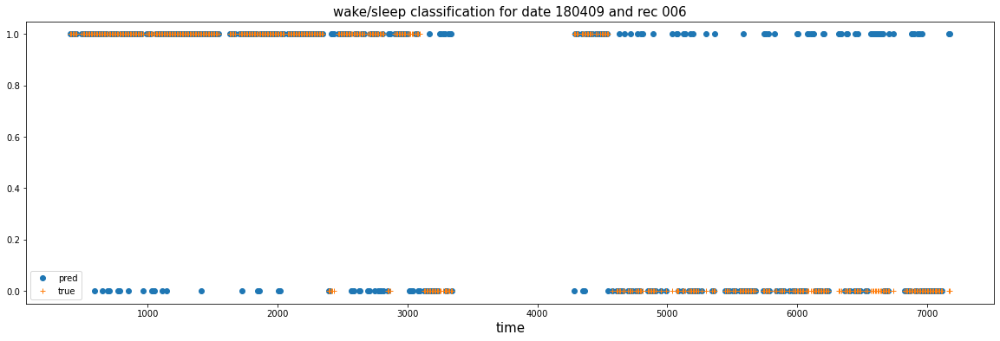

In [20]:
val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

test loss:1.2363322973251343, test accuracy:0.6488873751135331, test percentage postive:0.5


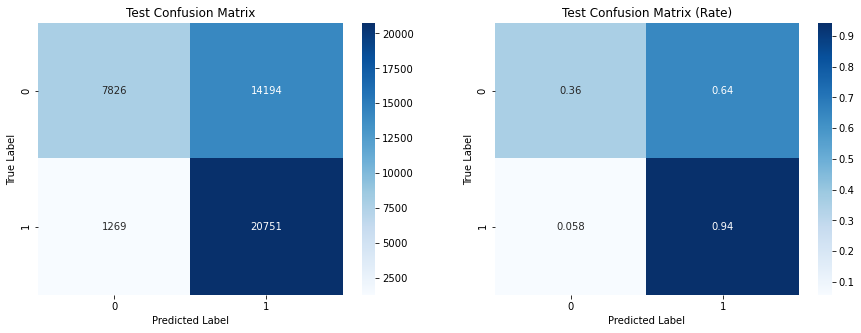

In [21]:
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 50)))


train_loss, train_acc, train_preds, train_preds_probs, train_labels, _, _, _, cases_wrong_train = evaluate(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('train loss:{}, train accuracy:{}, train percentage postive:{}'.format(train_loss, train_acc, np.mean(np.concatenate(train_labels))))
plot_confusion(train_preds, train_labels)

### SVM without regularization

In [28]:
learning_rate = 0.001
num_epochs = 51
alpha = 0 
model_type = 'SVM'
loss_type = 'hinge'
reg_type = 'none'

model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)

0
Train loss for epoch 0: 0.8659910559654236
Val loss for epoch 0: 1.8834887742996216
1
Train loss for epoch 1: 0.6276119351387024
Val loss for epoch 1: 1.298962950706482
2
Train loss for epoch 2: 0.6079375147819519
Val loss for epoch 2: 0.8472427129745483
4
Train loss for epoch 4: 0.571343719959259
Val loss for epoch 4: 0.8355676531791687
19
Train loss for epoch 19: 0.3171803951263428
Val loss for epoch 19: 0.8174880743026733


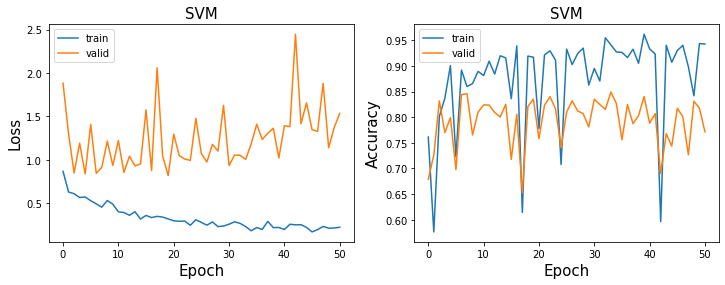

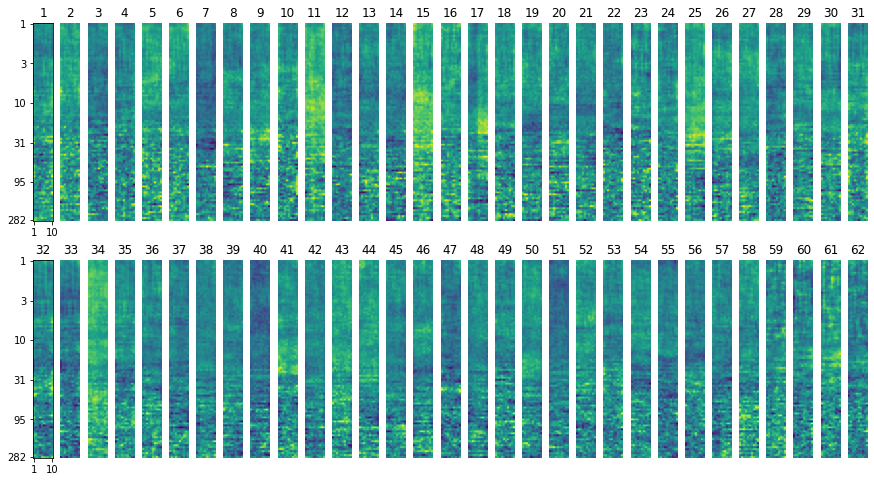

In [13]:
# with adjuested val and test dates
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

0
Train loss for epoch 0: 0.7938706874847412
Val loss for epoch 0: 0.7246323823928833


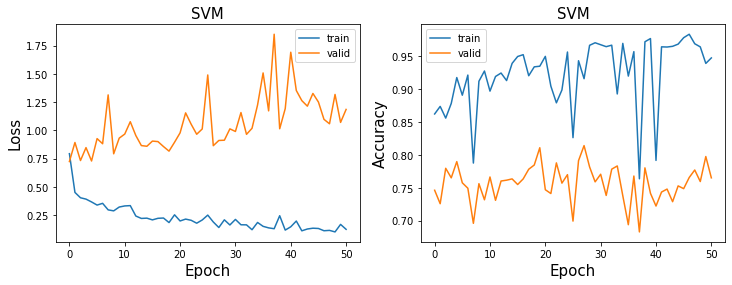

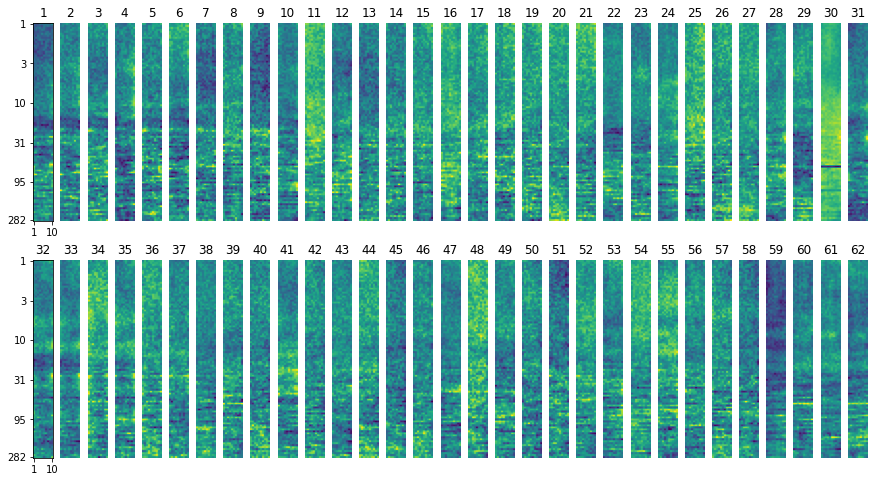

In [23]:
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

test loss:1.0301792621612549, test accuracy:0.7823606129768503, test percentage postive:0.7402999401092529


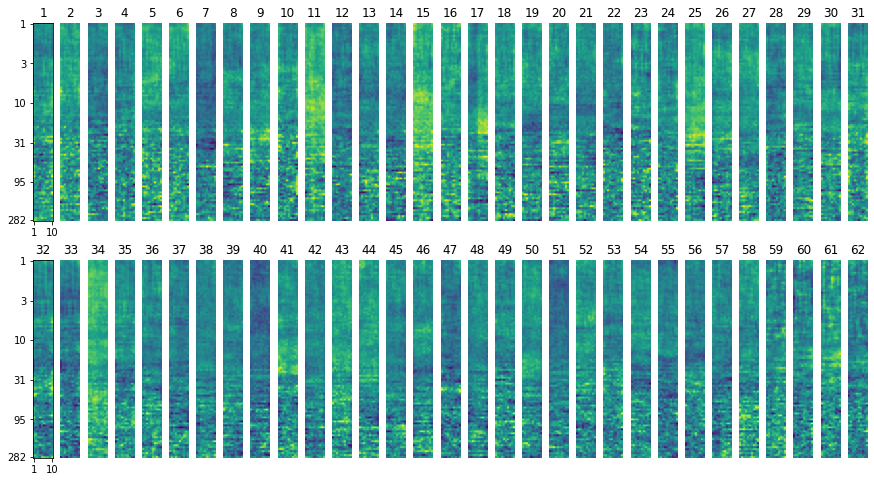

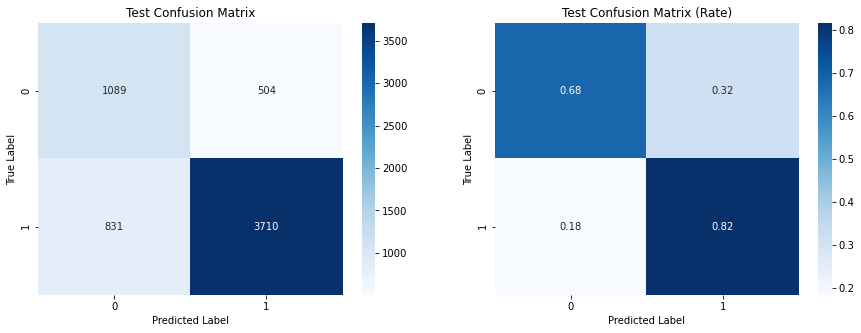

In [29]:
best_epoch = 19
model = GLM().to(device)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, best_epoch)))

test_loss, test_acc, test_preds, test_preds_probs, test_labels, _, _, _, _ = evaluate(model, optimizer, test_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(test_loss, test_acc, np.mean(np.concatenate(test_labels))))
plot_weight_glm(device, save_path, model_type, CH, loss_type, reg_type, alpha, best_epoch)
plot_confusion(test_preds, test_labels)

val loss:0.8174880743026733, val accuracy:0.8351963746223565, val percentage postive:0.8261329531669617


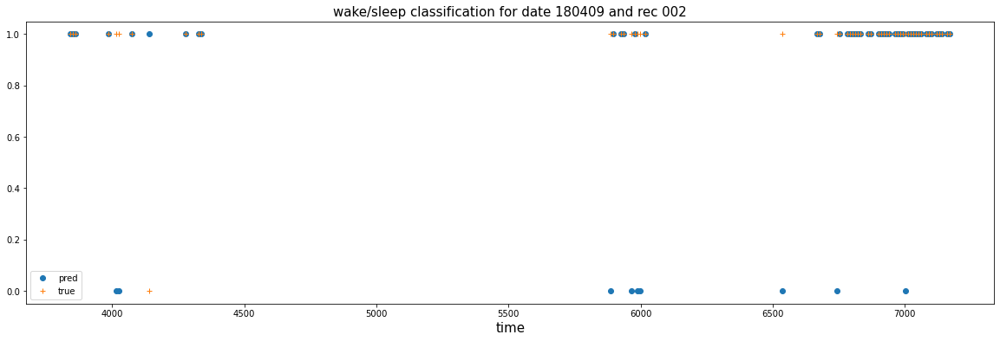

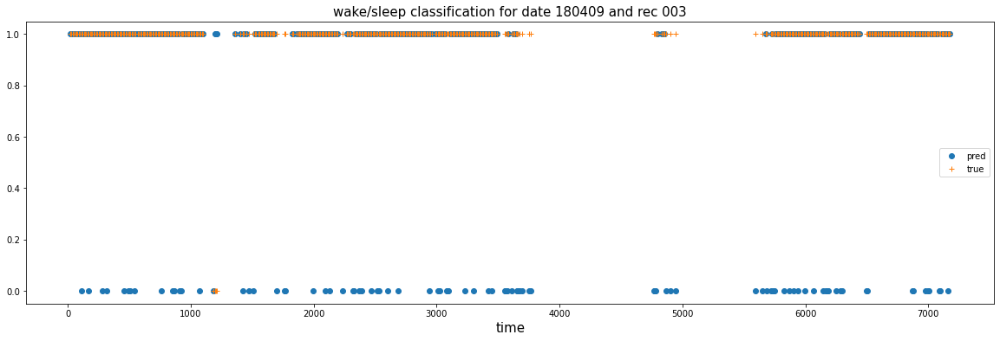

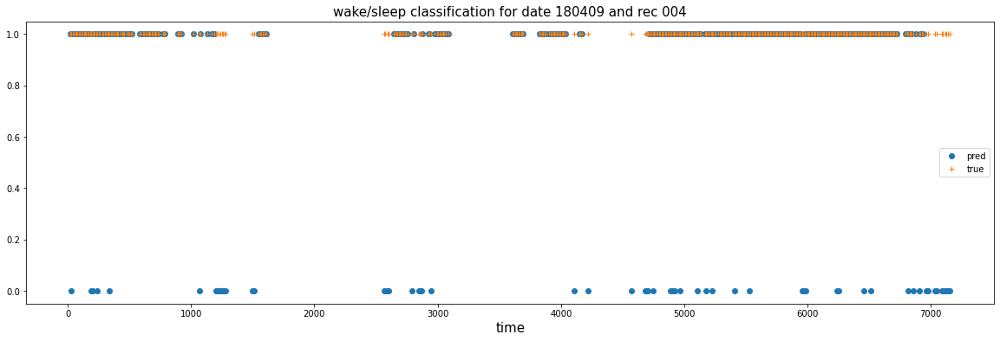

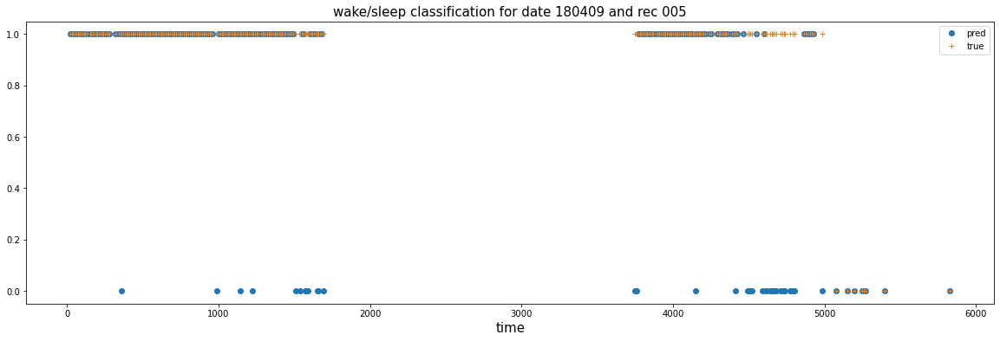

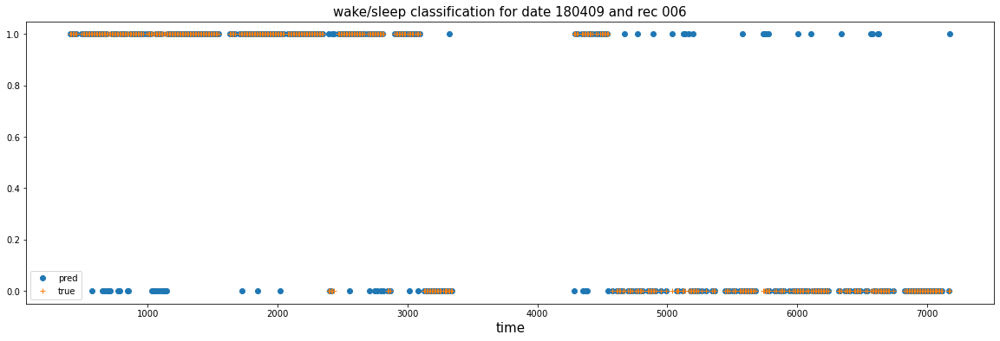

In [30]:
val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

test loss:0.2442585527896881, test accuracy:0.9344232515894642, test percentage postive:0.5


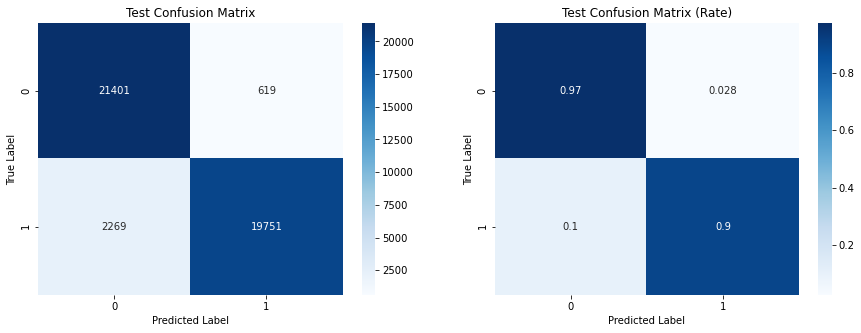

In [31]:
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 50)))


train_loss, train_acc, train_preds, train_preds_probs, train_labels, _, _, _, cases_wrong_train = evaluate(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(train_loss, train_acc, np.mean(np.concatenate(train_labels))))
plot_confusion(train_preds, train_labels)

### SVM with l2 regularization

In [32]:
learning_rate = 0.001
num_epochs = 51
alpha = 100
model_type = 'SVM'
loss_type = 'hinge'
reg_type = 'l2'

0
Train loss for epoch 0: 1.0959961414337158
Val loss for epoch 0: 2.6260907649993896
1
Train loss for epoch 1: 1.0287944078445435
Val loss for epoch 1: 1.374367594718933
2
Train loss for epoch 2: 0.9148710370063782
Val loss for epoch 2: 0.9674221873283386
3
Train loss for epoch 3: 0.9712654948234558
Val loss for epoch 3: 0.8492649793624878
5
Train loss for epoch 5: 0.829593300819397
Val loss for epoch 5: 0.5761207938194275
18
Train loss for epoch 18: 0.9014474749565125
Val loss for epoch 18: 0.5226558446884155
24
Train loss for epoch 24: 0.9561104774475098
Val loss for epoch 24: 0.4582265615463257


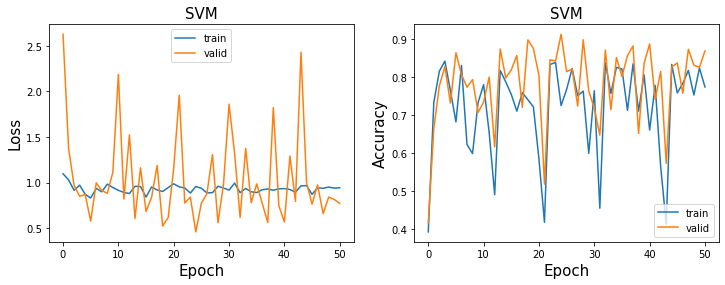

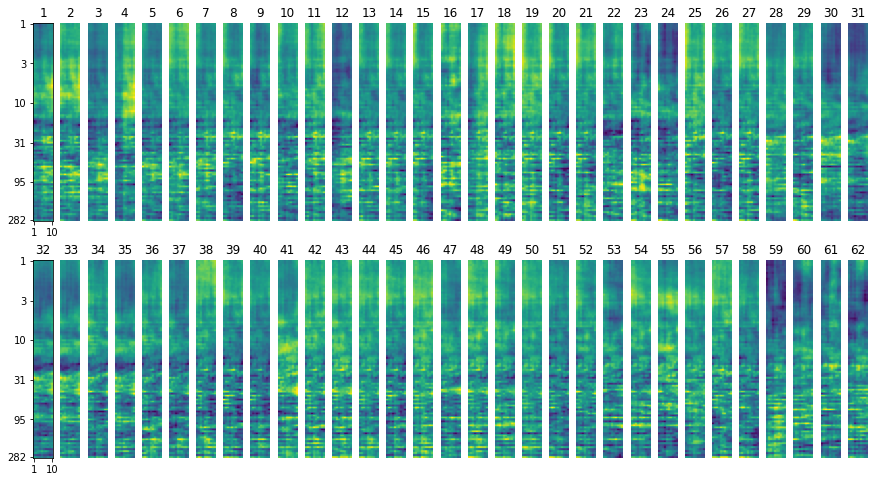

In [19]:
# with adjusted val and test dates
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

0
Train loss for epoch 0: 0.7987902760505676
Val loss for epoch 0: 0.8580793738365173
1
Train loss for epoch 1: 0.4598998427391052
Val loss for epoch 1: 0.6269670128822327


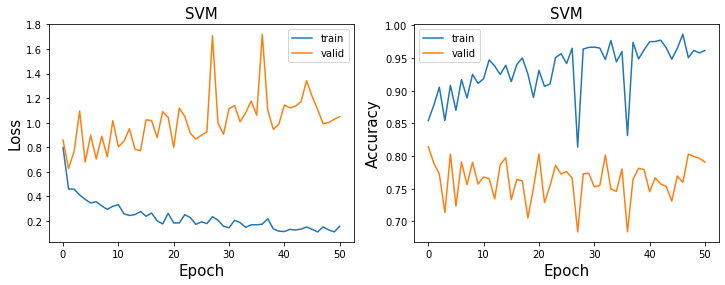

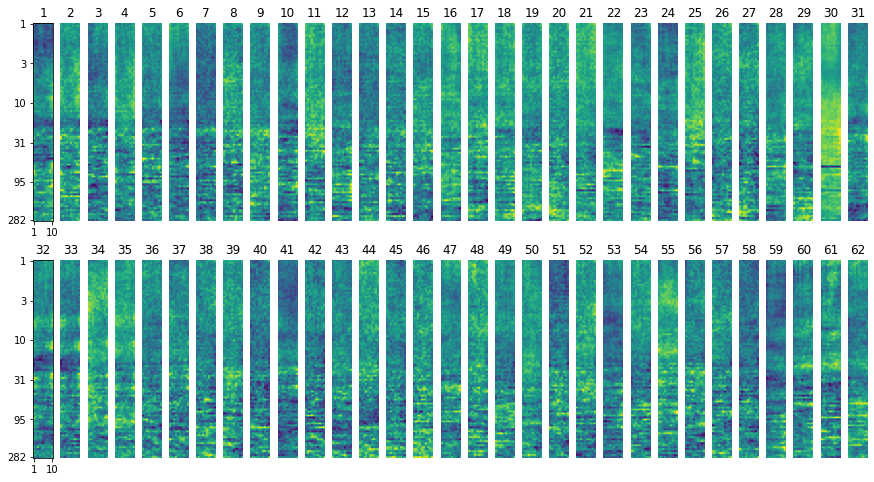

0
Train loss for epoch 0: 0.8531531691551208
Val loss for epoch 0: 0.6398067474365234
1
Train loss for epoch 1: 0.45819589495658875
Val loss for epoch 1: 0.5708131790161133


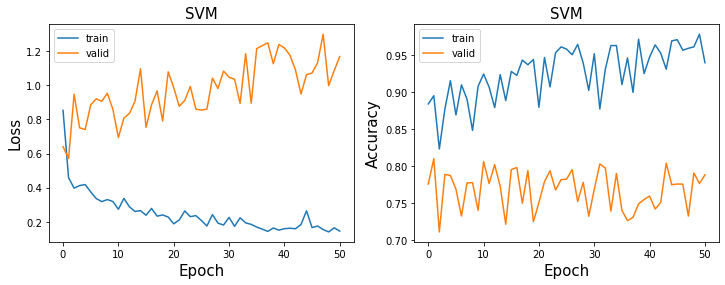

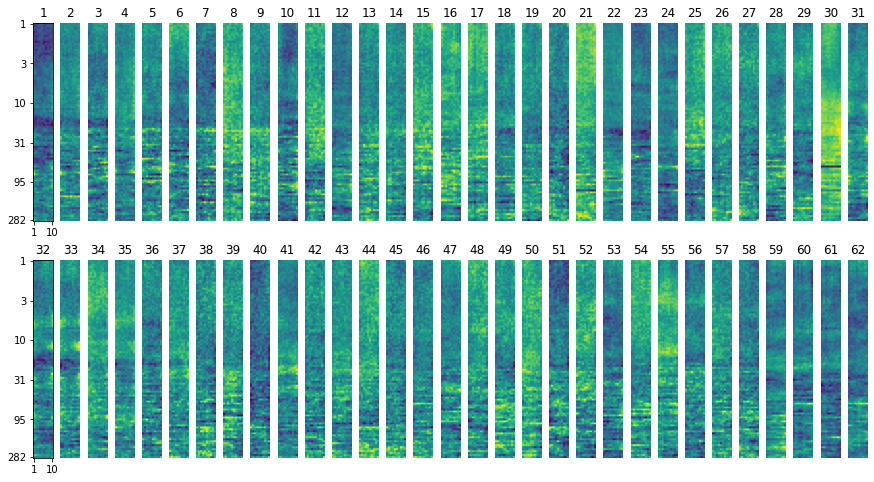

0
Train loss for epoch 0: 0.8413791656494141
Val loss for epoch 0: 0.6410686373710632


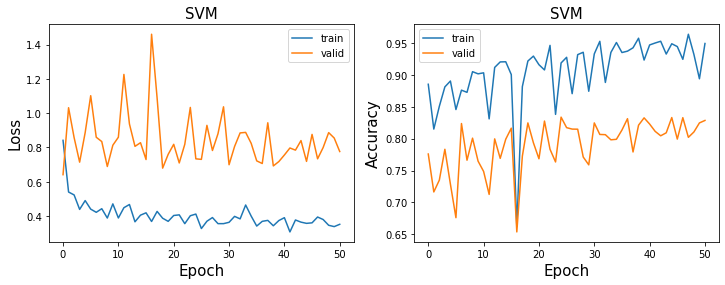

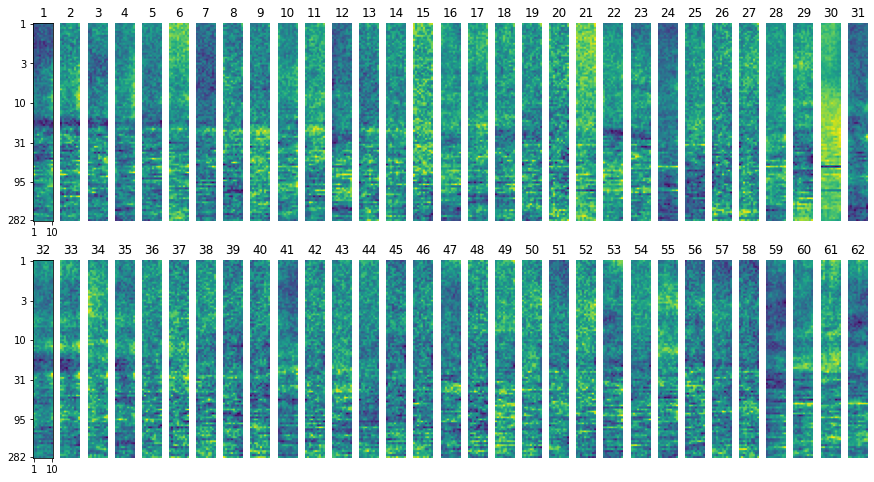

0
Train loss for epoch 0: 0.9417464137077332
Val loss for epoch 0: 1.273382306098938
1
Train loss for epoch 1: 0.6495169997215271
Val loss for epoch 1: 0.6610519886016846
16
Train loss for epoch 16: 0.5726920962333679
Val loss for epoch 16: 0.6294177174568176
23
Train loss for epoch 23: 0.6290642619132996
Val loss for epoch 23: 0.5669347047805786
24
Train loss for epoch 24: 0.5751135349273682
Val loss for epoch 24: 0.5392622351646423
41
Train loss for epoch 41: 0.5764374732971191
Val loss for epoch 41: 0.5307592749595642


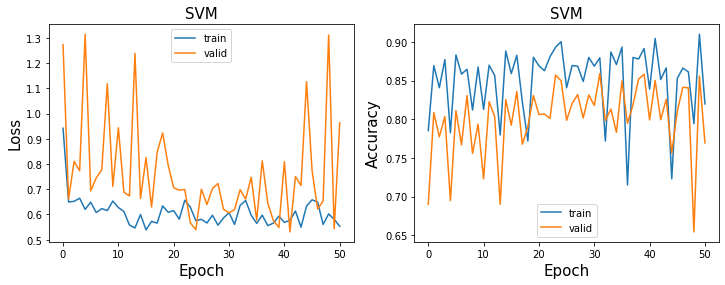

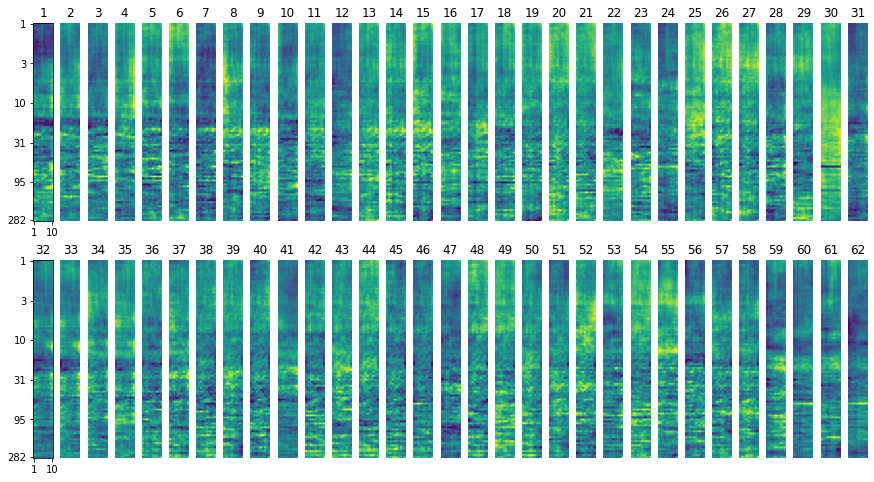

0
Train loss for epoch 0: 1.0280379056930542
Val loss for epoch 0: 1.08782958984375
1
Train loss for epoch 1: 0.7157201170921326
Val loss for epoch 1: 0.794643759727478
3
Train loss for epoch 3: 0.681792676448822
Val loss for epoch 3: 0.7221941351890564
4
Train loss for epoch 4: 0.7001256942749023
Val loss for epoch 4: 0.7111904621124268
6
Train loss for epoch 6: 0.6956763863563538
Val loss for epoch 6: 0.6870875358581543
8
Train loss for epoch 8: 0.6197578310966492
Val loss for epoch 8: 0.5963988900184631
10
Train loss for epoch 10: 0.6669440865516663
Val loss for epoch 10: 0.5641433596611023
36
Train loss for epoch 36: 0.6689038872718811
Val loss for epoch 36: 0.5477105975151062


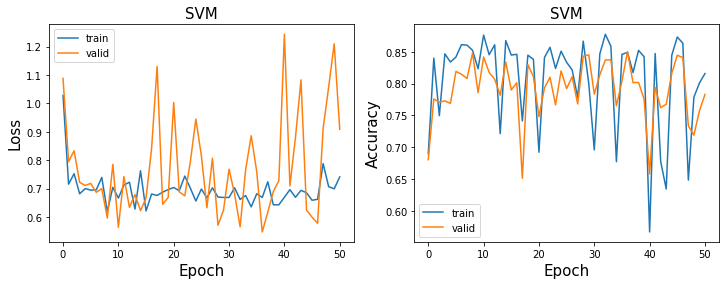

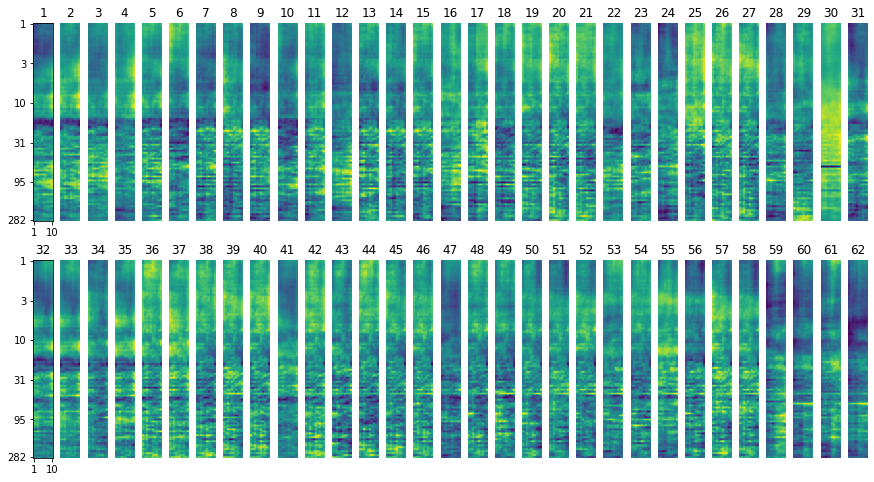

In [11]:
min_val_loss = 100
for alpha in [0.1, 1, 10, 50, 100]:
    model = GLM().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    best_epoch_alpha, min_val_loss_alpha = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)
    if min_val_loss_alpha < min_val_loss:
        min_val_loss = min_val_loss_alpha
        best_epoch = best_epoch_alpha
        best_alpha = alpha

test loss:0.7067978978157043, test accuracy:0.8053472448646887, test percentage postive:0.7402999401092529


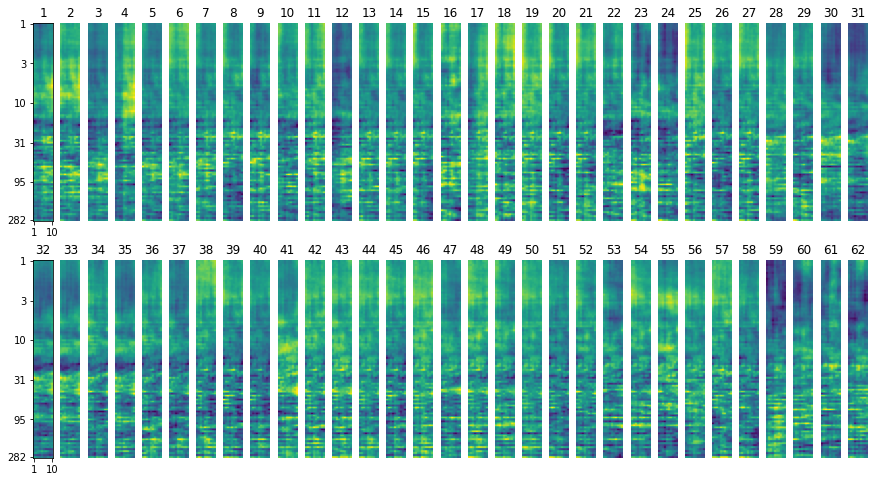

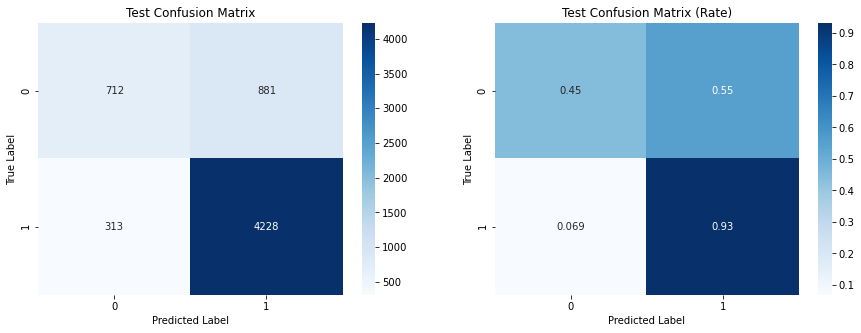

In [33]:
best_epoch, best_alpha = 24, 100
model = GLM().to(device)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)))

test_loss, test_acc, test_preds, test_preds_probs, test_labels, _, _, _, _ = evaluate(model, optimizer, test_loader, alpha=best_alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(test_loss, test_acc, np.mean(np.concatenate(test_labels))))
plot_weight_glm(device, save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)
plot_confusion(test_preds, test_labels)

val loss:0.4582265615463257, val accuracy:0.9123867069486404, val percentage postive:0.8261329531669617


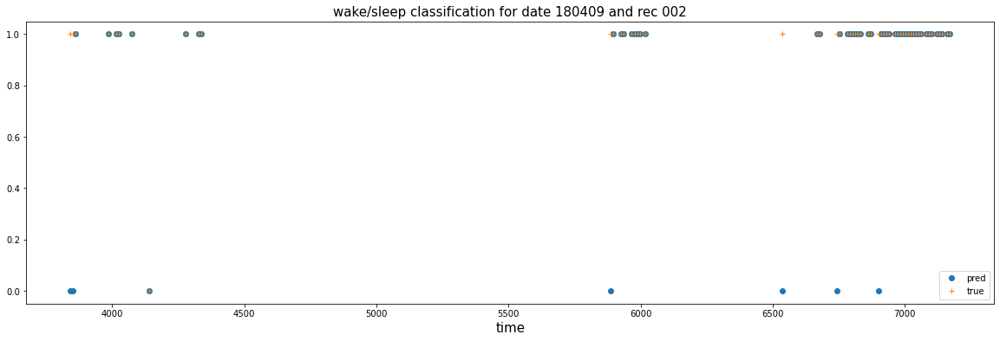

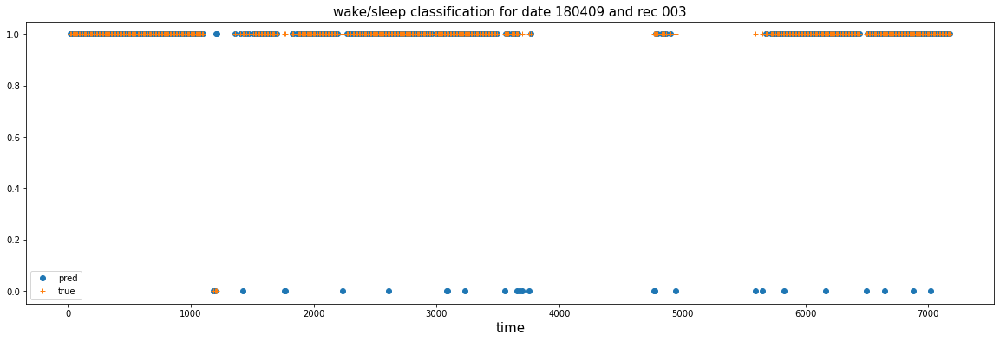

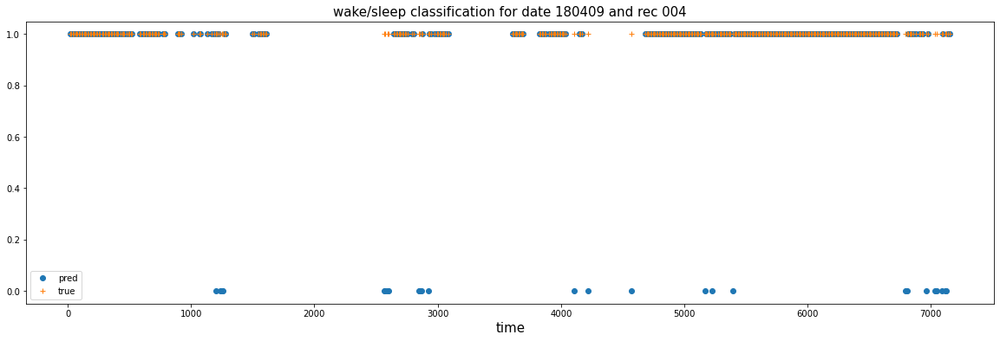

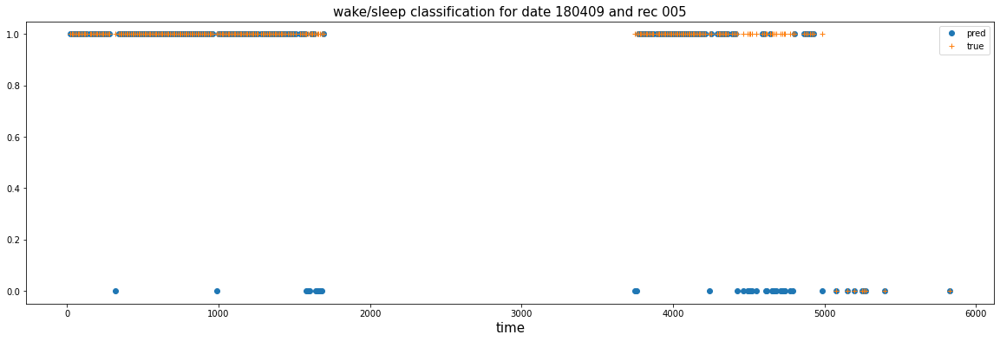

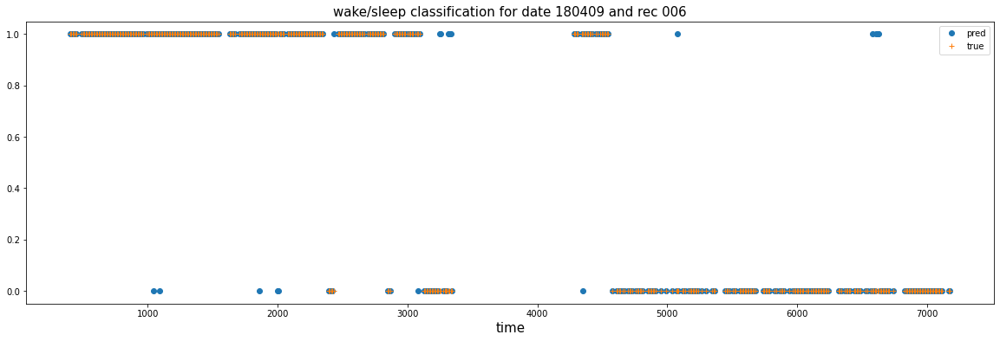

In [34]:
val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

test loss:1.0446498394012451, test accuracy:0.7725022706630336, test percentage postive:0.5


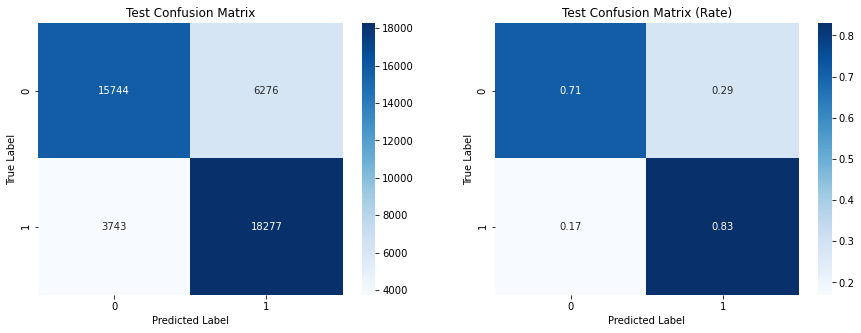

In [35]:
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 50)))


train_loss, train_acc, train_preds, train_preds_probs, train_labels, _, _, _, cases_wrong_train = evaluate(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(train_loss, train_acc, np.mean(np.concatenate(train_labels))))
plot_confusion(train_preds, train_labels)

### SVM with finite difference regularization

In [36]:
learning_rate = 0.001
num_epochs = 51
alpha = 100
model_type = 'SVM'
loss_type = 'hinge'
reg_type = 'finite_diff'

0
Train loss for epoch 0: 1.040889024734497
Val loss for epoch 0: 1.2272831201553345
4
Train loss for epoch 4: 0.7746341824531555
Val loss for epoch 4: 1.165407657623291
6
Train loss for epoch 6: 0.7982115745544434
Val loss for epoch 6: 0.9082721471786499
8
Train loss for epoch 8: 0.7585313320159912
Val loss for epoch 8: 0.6662524342536926
26
Train loss for epoch 26: 0.7205592393875122
Val loss for epoch 26: 0.5592326521873474


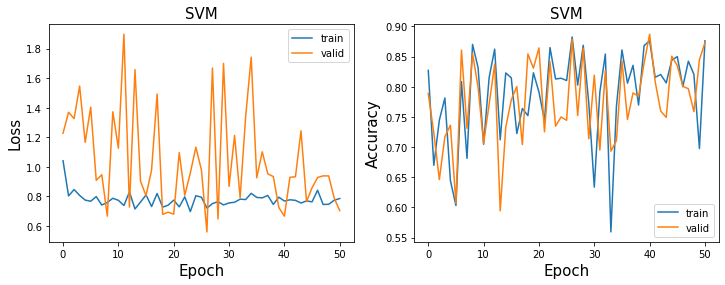

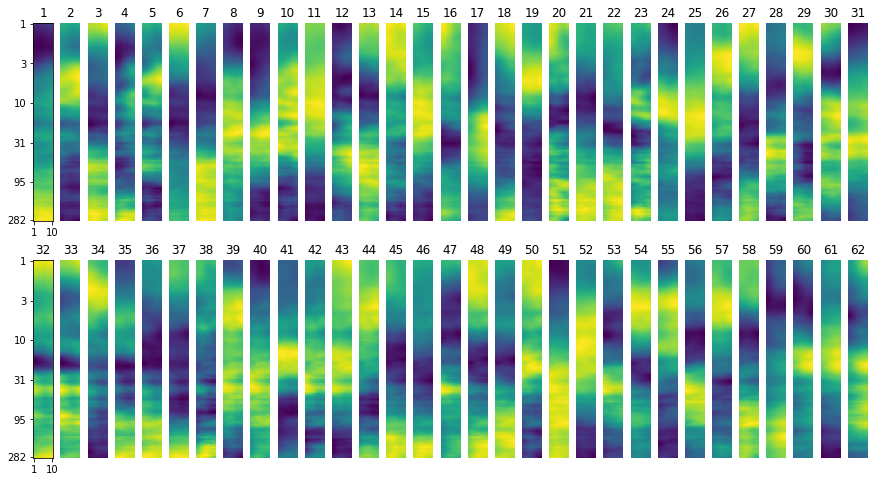

In [21]:
# with adjusted val and test dates
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
best_epoch, min_val_loss = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)

0
Train loss for epoch 0: 0.8545167446136475
Val loss for epoch 0: 0.9954687356948853
2
Train loss for epoch 2: 0.42893779277801514
Val loss for epoch 2: 0.7534669041633606
6
Train loss for epoch 6: 0.3086550533771515
Val loss for epoch 6: 0.7205923795700073


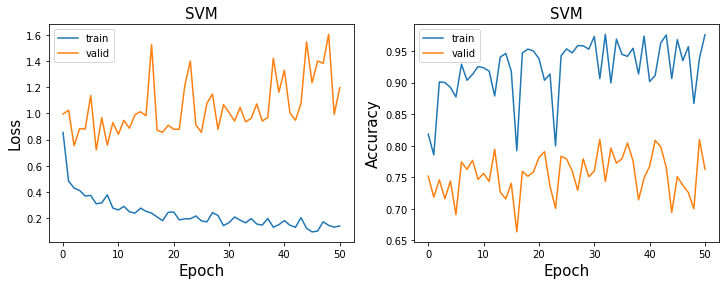

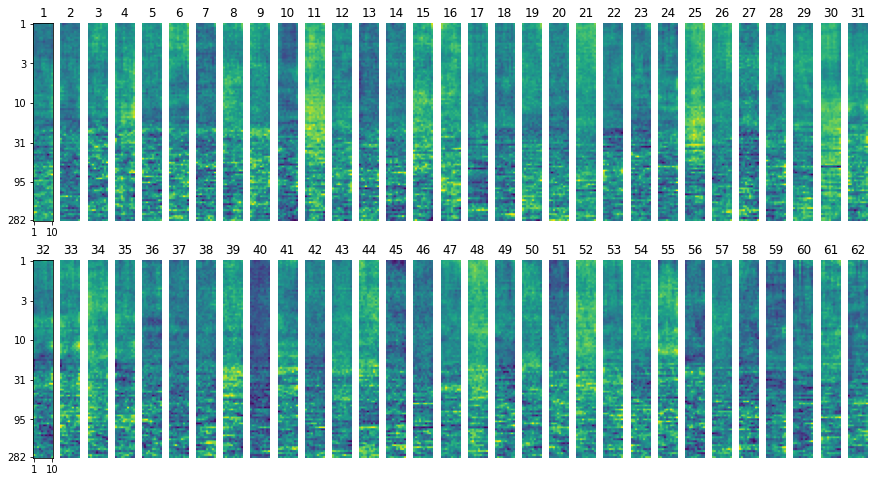

0
Train loss for epoch 0: 0.829262375831604
Val loss for epoch 0: 0.6772268414497375


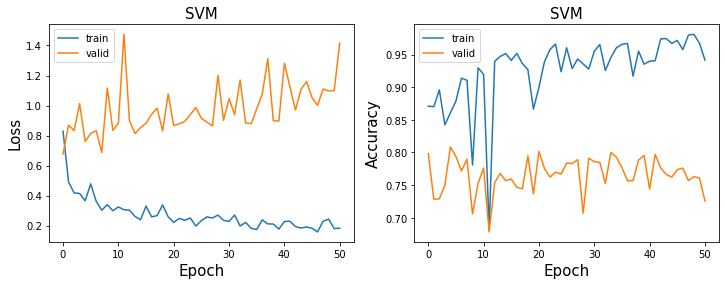

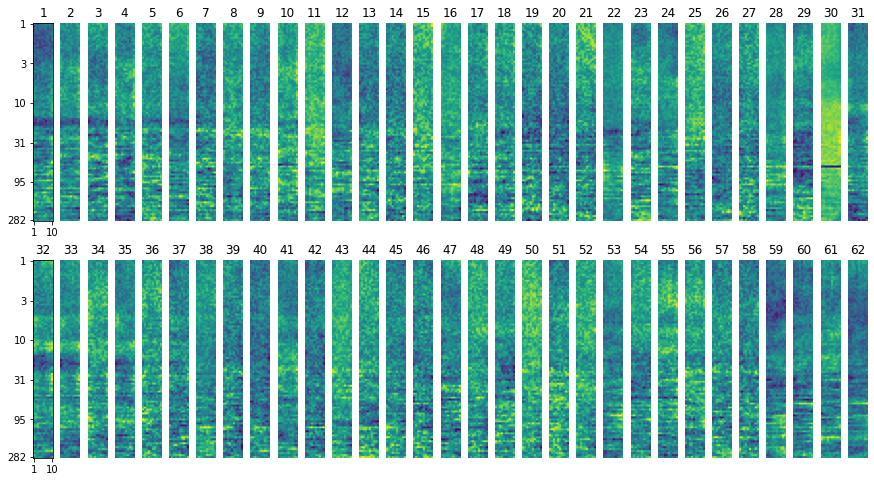

0
Train loss for epoch 0: 0.9077827334403992
Val loss for epoch 0: 0.8046154975891113
1
Train loss for epoch 1: 0.5080657005310059
Val loss for epoch 1: 0.69222092628479


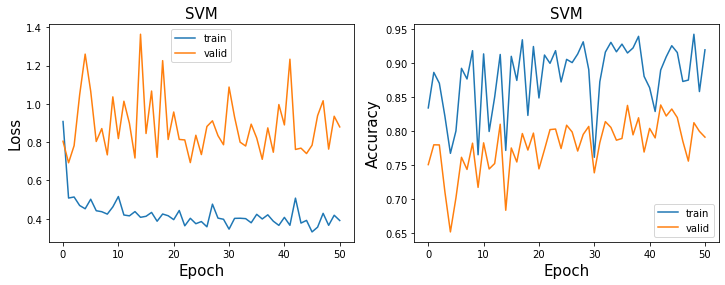

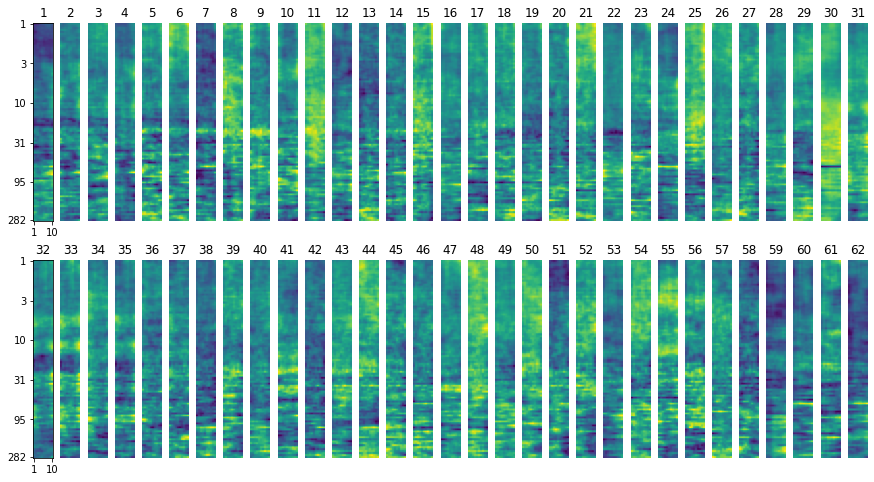

0
Train loss for epoch 0: 0.924010157585144
Val loss for epoch 0: 0.847959578037262
1
Train loss for epoch 1: 0.5996577143669128
Val loss for epoch 1: 0.7410489320755005
3
Train loss for epoch 3: 0.5530630946159363
Val loss for epoch 3: 0.7382981777191162
4
Train loss for epoch 4: 0.552980899810791
Val loss for epoch 4: 0.6992495059967041
5
Train loss for epoch 5: 0.5309416055679321
Val loss for epoch 5: 0.6736469268798828
13
Train loss for epoch 13: 0.5087133646011353
Val loss for epoch 13: 0.6208271384239197
15
Train loss for epoch 15: 0.4986090362071991
Val loss for epoch 15: 0.6139531135559082
31
Train loss for epoch 31: 0.45454534888267517
Val loss for epoch 31: 0.5973179340362549


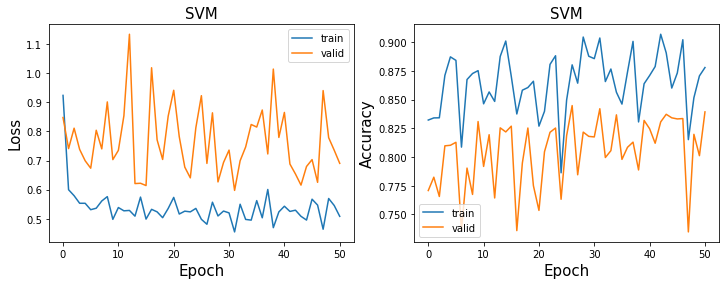

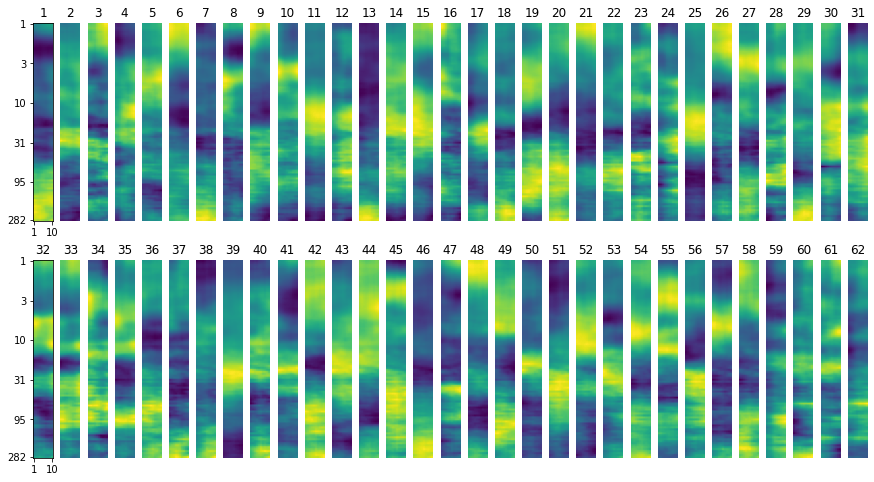

0
Train loss for epoch 0: 1.0016510486602783
Val loss for epoch 0: 0.77983158826828
1
Train loss for epoch 1: 0.5804525017738342
Val loss for epoch 1: 0.6460915803909302
6
Train loss for epoch 6: 0.5608260035514832
Val loss for epoch 6: 0.6228933930397034
12
Train loss for epoch 12: 0.5492098927497864
Val loss for epoch 12: 0.6008210778236389
25
Train loss for epoch 25: 0.5486419200897217
Val loss for epoch 25: 0.5712255239486694


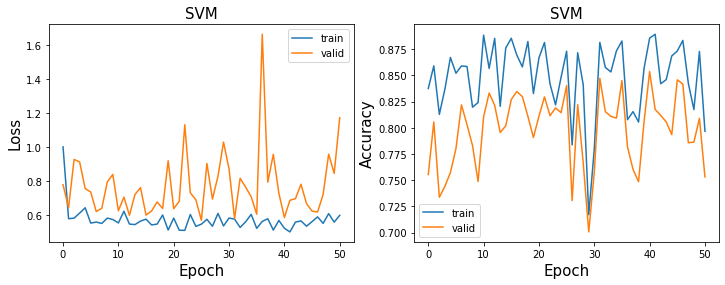

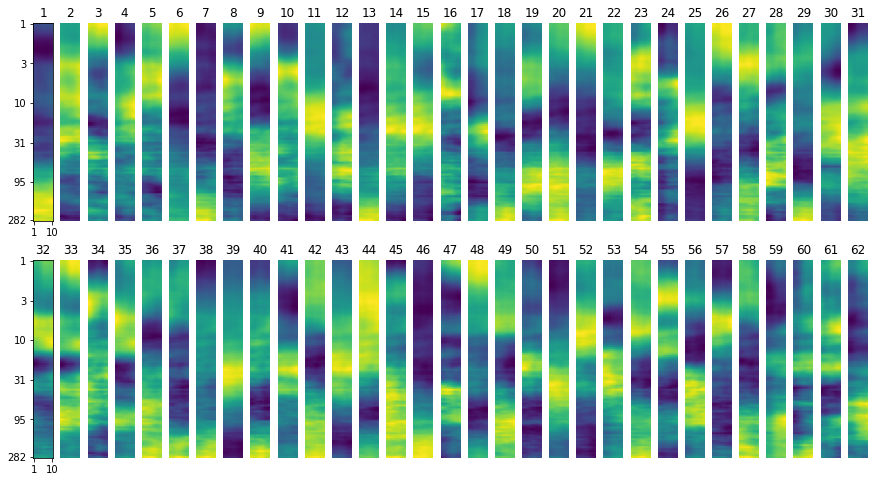

In [33]:
min_val_loss = 100
for alpha in [0.1, 1, 10, 50, 100]:
    model = GLM().to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    best_epoch_alpha, min_val_loss_alpha = tuning(train_loader, val_loader, model, optimizer, device, num_epochs, alpha, model_type, loss_type, reg_type, CH, save_path)
    if min_val_loss_alpha < min_val_loss:
        min_val_loss = min_val_loss_alpha
        best_epoch = best_epoch_alpha
        best_alpha = alpha

test loss:0.658461332321167, test accuracy:0.8438213237691555, test percentage postive:0.7402999401092529


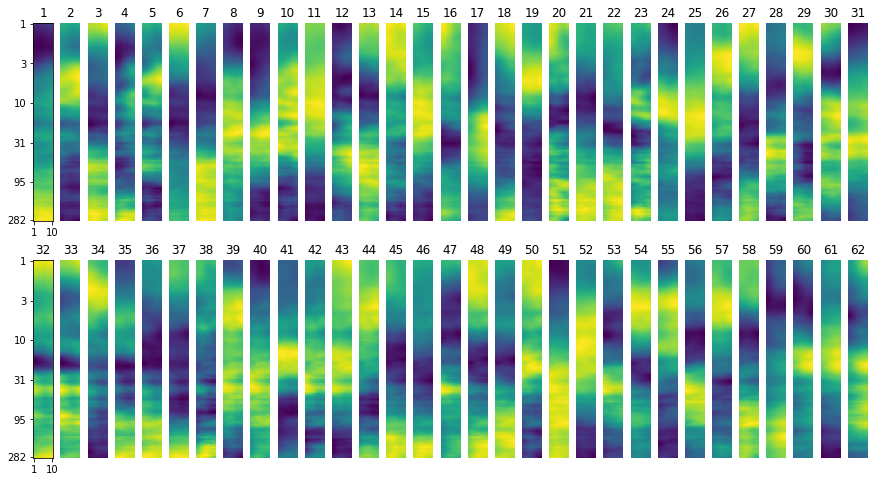

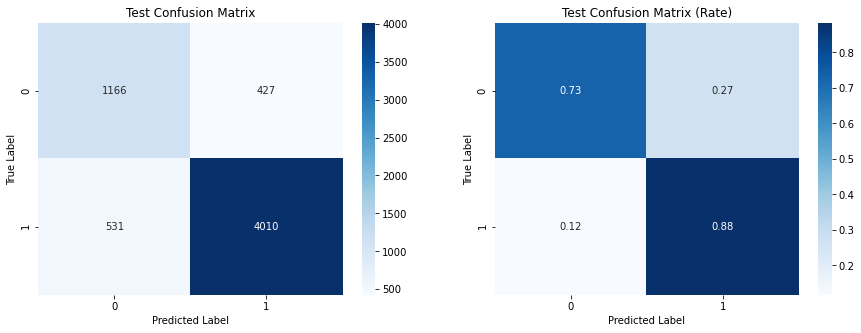

In [38]:
best_epoch, best_alpha = 26, 100
model = GLM().to(device)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)))

test_loss, test_acc, test_preds, test_preds_probs, test_labels, _, _, _, _ = evaluate(model, optimizer, test_loader, alpha=best_alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(test_loss, test_acc, np.mean(np.concatenate(test_labels))))
plot_weight_glm(device, save_path, model_type, CH, loss_type, reg_type, best_alpha, best_epoch)
plot_confusion(test_preds, test_labels)

val loss:0.5592326521873474, val accuracy:0.8787009063444109, val percentage postive:0.8261329531669617


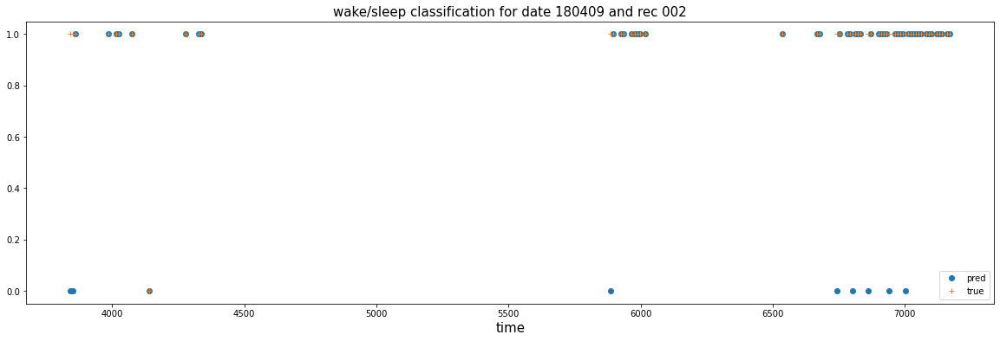

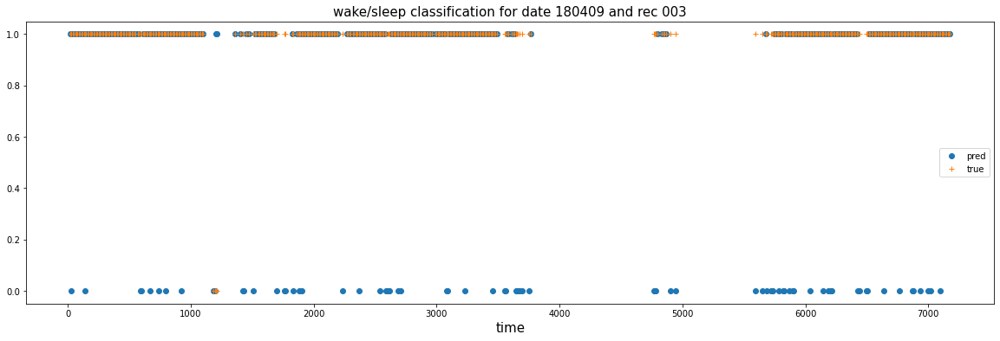

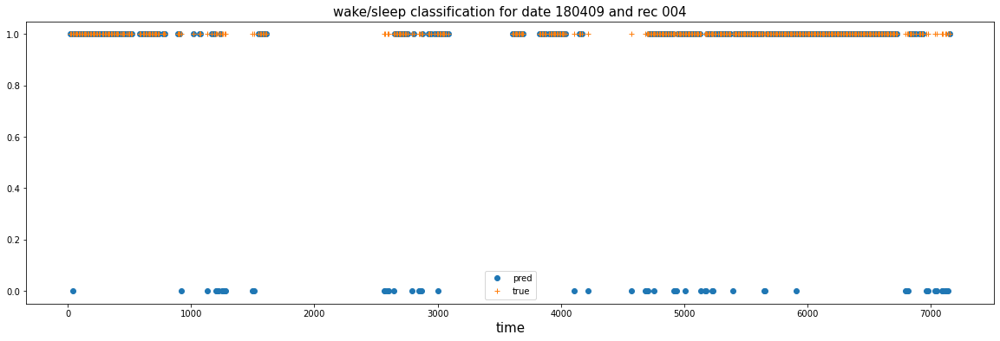

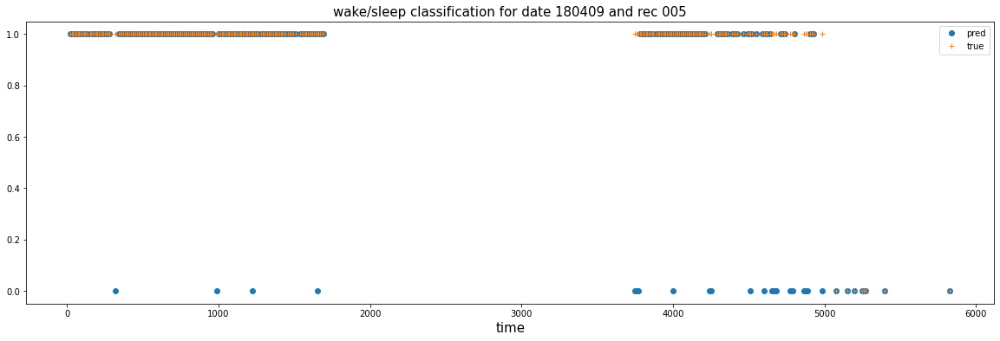

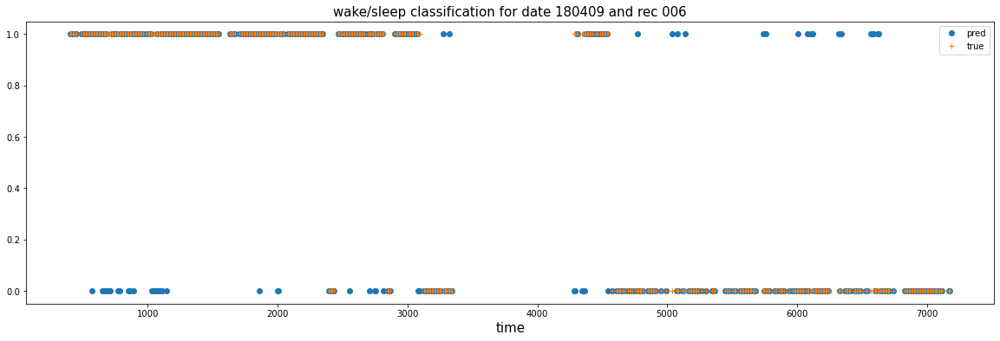

In [39]:
val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

test loss:0.6720823049545288, test accuracy:0.8751589464123524, test percentage postive:0.5


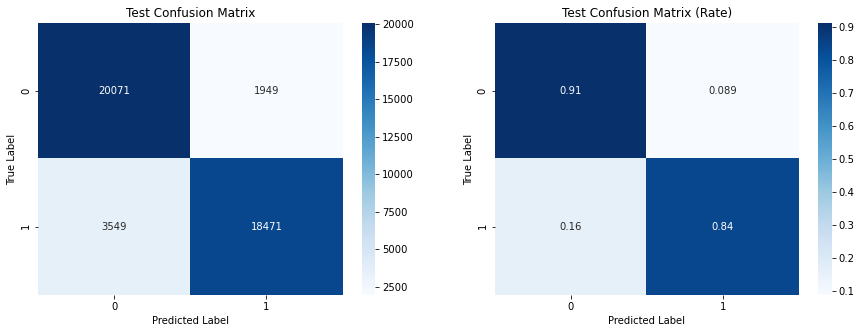

In [40]:
model = GLM().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_EPOCH{}_REDUCEsum.pt'.format(save_path, model_type, CH, loss_type, reg_type, alpha, 50)))


train_loss, train_acc, train_preds, train_preds_probs, train_labels, _, _, _, cases_wrong_train = evaluate(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
print('test loss:{}, test accuracy:{}, test percentage postive:{}'.format(train_loss, train_acc, np.mean(np.concatenate(train_labels))))
plot_confusion(train_preds, train_labels)